### Loading Packages and Data

In [1]:
%matplotlib inline
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
pd.set_option('display.max_rows', 8)

#import xarray as xr
import warnings
warnings.filterwarnings('ignore')
from matplotlib.backends.backend_pdf import PdfPages

from db_queries import get_outputs as go
from db_queries import get_ids
from get_draws.api import get_draws

In [2]:
ls /mnt/team/simulation_science/priv/engineering/vivarium_nih_us_cvd/19.5_51_locations/results_data

deaths.csv                       sbp_medication_person_time.csv
deaths.hdf                       sbp_medication_person_time.hdf
healthcare_visits.csv            state_person_time.csv
healthcare_visits.hdf            state_person_time.hdf
intervention_person_time.csv     transition_count.csv
intervention_person_time.hdf     transition_count.hdf
ldlc_medication_person_time.csv  ylds.csv
ldlc_medication_person_time.hdf  ylds.hdf
risk_exposure_time.csv           ylls.csv
risk_exposure_time.hdf           ylls.hdf


In [3]:
sim_results_dir = '/mnt/team/simulation_science/priv/engineering/vivarium_nih_us_cvd/19.5_51_locations/results_data/'

### Exploring Data

In [4]:
deaths = pd.read_csv(sim_results_dir + 'deaths.csv')
deaths.head()

,Unnamed: 0,sex,year,cause,measure,input_draw,scenario,age,value,location
0,0,Female,2021,acute_ischemic_stroke,deaths,829,baseline,25_to_29,0.0,washington
1,1,Female,2021,acute_ischemic_stroke,deaths,829,lifestyle_100,25_to_29,0.0,washington
2,2,Female,2021,acute_ischemic_stroke,deaths,829,outreach_100,25_to_29,0.0,washington
3,3,Female,2021,acute_ischemic_stroke,deaths,829,polypill_100,25_to_29,0.0,washington
4,4,Female,2021,acute_ischemic_stroke,deaths,829,baseline,30_to_34,0.0,washington


In [5]:
tran = pd.read_csv(sim_results_dir + 'transition_count.csv')

In [6]:
state_person_time = pd.read_csv(sim_results_dir + '/state_person_time.csv')
person_time = state_person_time.loc[state_person_time['state'].isin(["acute_ischemic_stroke", "chronic_ischemic_stroke", "susceptible_to_ischemic_stroke"])].reset_index() 
person_time.value.sum()

147162423.30458596

### Total DALYs by Year

In [7]:
yll = pd.read_csv(sim_results_dir + 'ylls.csv')
yll = yll.rename(columns = {'value':'yll'})
yll_total = yll.groupby(['sex', 'age', 'input_draw', 'year','scenario','location']).yll.sum().reset_index()
yld = pd.read_csv(sim_results_dir + 'ylds.csv')
yld = yld.rename(columns = {'value':'yld'})
yld_total = yld.groupby(['sex', 'age', 'input_draw', 'year','scenario','location']).yld.sum().reset_index()
daly_total = pd.concat([yll_total, yld_total.yld], axis=1)
daly_total['daly'] = daly_total['yll'] + daly_total['yld'] 

daly_total.head()

,sex,age,input_draw,year,scenario,location,yll,yld,daly
0,Female,25_to_29,829,2021,baseline,alaska,121.205871,2.453672,123.659544
1,Female,25_to_29,829,2021,baseline,arizona,60.969459,1.999969,62.969428
2,Female,25_to_29,829,2021,baseline,arkansas,61.999688,2.554379,64.554068
3,Female,25_to_29,829,2021,baseline,california,0.000000,0.699069,0.699069
4,Female,25_to_29,829,2021,baseline,colorado,60.751526,2.448676,63.200203


In [8]:
daly_sum = (daly_total
                .groupby(['year','scenario','location'])
                .daly.describe(percentiles=[.025, .975])
                .filter(['mean', '2.5%', '97.5%'])
                .reset_index())

daly_sum.head()

,year,scenario,location,mean,2.5%,97.5%
0,2021,baseline,alaska,282.367519,26.686859,571.862276
1,2021,baseline,arizona,361.644054,46.228619,849.332301
2,2021,baseline,arkansas,455.979333,73.175488,904.448889
3,2021,baseline,california,321.854767,35.352534,623.360616
4,2021,baseline,colorado,296.072529,40.467049,715.668913


### All Cause Mortality Graphs

In [9]:
result_summary = (deaths
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .value.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

result_summary.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.250,0.0,1.650
1,25_to_29,Female,2021,baseline,arizona,0.125,0.0,0.825
2,25_to_29,Female,2021,baseline,arkansas,0.125,0.0,0.825
3,25_to_29,Female,2021,baseline,california,0.000,0.0,0.000
4,25_to_29,Female,2021,baseline,colorado,0.125,0.0,0.825


#### All Cause Mortality Graph with Rate

In [10]:
person_time = person_time.rename(columns = {'value':'ptvalue'})
per_time_group = person_time.groupby(['age', 'sex', 'year', 'input_draw','scenario','location']).ptvalue.sum().reset_index()

per_time_group.head()

,age,sex,year,input_draw,scenario,location,ptvalue
0,25_to_29,Female,2021,829,baseline,alaska,1906.913073
1,25_to_29,Female,2021,829,baseline,arizona,1945.242984
2,25_to_29,Female,2021,829,baseline,arkansas,1863.830253
3,25_to_29,Female,2021,829,baseline,california,2101.015743
4,25_to_29,Female,2021,829,baseline,colorado,1897.637235


In [11]:
results_rate = deaths.groupby(['age', 'sex', 'year', 'input_draw','scenario','location']).value.sum().reset_index()
results_rate = pd.concat([results_rate, per_time_group.ptvalue], axis=1)
results_rate['mean_rate'] = results_rate['value'] / results_rate['ptvalue']
result_summary = (results_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

result_summary.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.001049,0.001049,0.001049
1,25_to_29,Female,2021,baseline,arizona,0.000514,0.000514,0.000514
2,25_to_29,Female,2021,baseline,arkansas,0.000537,0.000537,0.000537
3,25_to_29,Female,2021,baseline,california,0.000000,0.000000,0.000000
4,25_to_29,Female,2021,baseline,colorado,0.000527,0.000527,0.000527


In [12]:
result_summary_allage = (results_rate
                      .groupby(['sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

result_summary_allage.head()

,sex,year,scenario,location,mean,2.5%,97.5%
0,Female,2021,baseline,alaska,0.041001,0.001211,0.200195
1,Female,2021,baseline,arizona,0.034477,0.000180,0.167301
2,Female,2021,baseline,arkansas,0.059168,0.000726,0.307394
3,Female,2021,baseline,california,0.043654,0.000179,0.243658
4,Female,2021,baseline,colorado,0.035063,0.000703,0.198114


In [13]:
result_summary_allsex = (results_rate
                      .groupby(['age', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

result_summary_allsex.head()

,age,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,2021,baseline,alaska,0.001685,0.001081,0.002289
1,25_to_29,2021,baseline,arizona,0.003000,0.000638,0.005362
2,25_to_29,2021,baseline,arkansas,0.001330,0.000576,0.002084
3,25_to_29,2021,baseline,california,0.000907,0.000045,0.001768
4,25_to_29,2021,baseline,colorado,0.002773,0.000639,0.004908


### Cause Specific Mortality Graphs
#### Acute Stroke

In [14]:
deaths_cause = (deaths
               .groupby(['age', 'sex', 'year', 'cause','scenario','location'])
               .value.describe(percentiles=[.025, .975])
               .filter(['mean', '2.5%', '97.5%'])
               .reset_index())

acute = deaths_cause.loc[(deaths_cause['cause'] == 'acute_ischemic_stroke')].reset_index()

acute.head()

,index,age,sex,year,cause,scenario,location,mean,2.5%,97.5%
0,0,25_to_29,Female,2021,acute_ischemic_stroke,baseline,alaska,0.0,0.0,0.0
1,1,25_to_29,Female,2021,acute_ischemic_stroke,baseline,arizona,0.0,0.0,0.0
2,2,25_to_29,Female,2021,acute_ischemic_stroke,baseline,arkansas,0.0,0.0,0.0
3,3,25_to_29,Female,2021,acute_ischemic_stroke,baseline,california,0.0,0.0,0.0
4,4,25_to_29,Female,2021,acute_ischemic_stroke,baseline,colorado,0.0,0.0,0.0


In [15]:
death_rate_cause = deaths.groupby(['age', 'sex', 'year', 'input_draw', 'cause','scenario','location']).value.sum().reset_index()
acute_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'acute_ischemic_stroke')].reset_index()
acute_rate.head()

,index,age,sex,year,input_draw,cause,scenario,location,value
0,0,25_to_29,Female,2021,829,acute_ischemic_stroke,baseline,alaska,0.0
1,1,25_to_29,Female,2021,829,acute_ischemic_stroke,baseline,arizona,0.0
2,2,25_to_29,Female,2021,829,acute_ischemic_stroke,baseline,arkansas,0.0
3,3,25_to_29,Female,2021,829,acute_ischemic_stroke,baseline,california,0.0
4,4,25_to_29,Female,2021,829,acute_ischemic_stroke,baseline,colorado,0.0


In [16]:
acute_rate_2 = pd.concat([acute_rate, per_time_group.ptvalue], axis=1)
acute_rate_2['mean_rate'] = acute_rate_2['value'] / acute_rate_2['ptvalue']

acute_rate_summary = (acute_rate_2
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

acute_rate_summary.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


#### Chronic Stroke

In [17]:
chronic_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'chronic_ischemic_stroke')].reset_index()
chronic_rate = pd.concat([chronic_rate, per_time_group.ptvalue], axis=1)
chronic_rate['mean_rate'] = chronic_rate['value'] / chronic_rate['ptvalue']
chronic_rate_summ = (chronic_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

chronic_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


### CSMR for All Stroke

In [18]:
stroke_rate = death_rate_cause.loc[(death_rate_cause['cause'].isin(['chronic_ischemic_stroke','acute_ischemic_stroke']))].reset_index()
stroke_rate = stroke_rate.groupby(['age', 'sex', 'year','scenario','input_draw','location']).value.sum().reset_index()
stroke_rate = stroke_rate.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw', 'scenario','location'])
stroke_rate['mean_rate'] = stroke_rate['value'] / stroke_rate['ptvalue']
stroke_rate_summ = (stroke_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

stroke_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


### CSMR for All IHD 

In [19]:
IHD_rate = death_rate_cause.loc[(death_rate_cause['cause'].isin(['acute_myocardial_infarction','acute_myocardial_infarction_and_heart_failure','heart_failure_from_ischemic_heart_disease','heart_failure_residual','post_myocardial_infarction']))].reset_index()
IHD_rate = IHD_rate.groupby(['age', 'sex', 'year','scenario','input_draw','location']).value.sum().reset_index()
IHD_rate = IHD_rate.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw', 'scenario','location'])
IHD_rate['mean_rate'] = IHD_rate['value'] / IHD_rate['ptvalue']
IHD_rate_summ = (IHD_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

IHD_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000000,0.000000,0.000000
1,25_to_29,Female,2021,baseline,arizona,0.000514,0.000514,0.000514
2,25_to_29,Female,2021,baseline,arkansas,0.000537,0.000537,0.000537
3,25_to_29,Female,2021,baseline,california,0.000000,0.000000,0.000000
4,25_to_29,Female,2021,baseline,colorado,0.000527,0.000527,0.000527


#### Acute Myocardial Infarction - includes both heart failure and no heart failure

In [20]:
acute_MI_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'acute_myocardial_infarction') | (death_rate_cause['cause'] == 'acute_myocardial_infarction_and_heart_failure')].reset_index()
acute_MI_rate = acute_MI_rate.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw', 'scenario','location'])
acute_MI_rate['mean_rate'] = acute_MI_rate['value'] / acute_MI_rate['ptvalue']
acute_MI_rate_summ = (acute_MI_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

acute_MI_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


#### Post Myocaridal Infarction

In [21]:
post_MI_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'post_myocardial_infarction')].reset_index()
post_MI_rate = pd.concat([post_MI_rate, per_time_group.ptvalue], axis=1)
post_MI_rate['mean_rate'] = post_MI_rate['value'] / post_MI_rate['ptvalue']
post_MI_rate_summ = (post_MI_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

post_MI_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


#### Heart Failure

In [22]:
HF_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'heart_failure_from_ischemic_heart_disease') | (death_rate_cause['cause'] == 'heart_failure_residual')].reset_index()
HF_rate = HF_rate.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
HF_rate['mean_rate'] = HF_rate['value'] / HF_rate['ptvalue']
HF_rate_summ = (HF_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

HF_rate_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000000,0.000000,0.000000
1,25_to_29,Female,2021,baseline,arizona,0.000257,0.000013,0.000501
2,25_to_29,Female,2021,baseline,arkansas,0.000268,0.000013,0.000523
3,25_to_29,Female,2021,baseline,california,0.000000,0.000000,0.000000
4,25_to_29,Female,2021,baseline,colorado,0.000263,0.000013,0.000514


### Excess Mortality rate

#### Post Myocardial Infarction

In [23]:
per_time_state = state_person_time.groupby(['age', 'sex', 'year', 'state', 'input_draw','scenario','location']).value.sum().reset_index()
per_time_state = per_time_state.rename(columns = {'value':'ptvalue'})
per_time_post_MI = per_time_state.loc[(per_time_state['state'] == 'post_myocardial_infarction')].reset_index()

post_MI_emr = death_rate_cause.loc[(death_rate_cause['cause'] == 'post_myocardial_infarction')].reset_index()
post_MI_emr = pd.concat([post_MI_emr, per_time_post_MI.ptvalue], axis=1)
post_MI_emr['mean_rate'] = post_MI_emr['value'] / post_MI_emr['ptvalue']
post_MI_emr_summ = (post_MI_emr
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

post_MI_emr_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


#### Heart Failure EMR

In [24]:
per_time_HF = per_time_state.loc[(per_time_state['state'] == 'heart_failure_from_ischemic_heart_disease') | (per_time_state['state'] == 'heart_failure_residual')].reset_index()
HF_emr = death_rate_cause.loc[(death_rate_cause['cause'] == 'heart_failure_from_ischemic_heart_disease') | (death_rate_cause['cause'] == 'heart_failure_residual')].reset_index()
HF_emr = HF_emr.merge(per_time_HF[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
HF_emr['mean_rate'] = HF_emr['value'] / HF_emr['ptvalue']
HF_emr_summ = (HF_emr
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

HF_emr_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.00000,0.000000,0.000000
1,25_to_29,Female,2021,baseline,arizona,inf,0.010191,NaN
2,25_to_29,Female,2021,baseline,arkansas,inf,0.008814,NaN
3,25_to_29,Female,2021,baseline,california,0.00000,0.000000,0.000000
4,25_to_29,Female,2021,baseline,colorado,0.45941,0.000000,1.523816


##### Looks weird check with artifact values

### All IHD EMR

In [25]:
per_time_IHD = per_time_state.loc[(per_time_state['state'].isin(["acute_myocardial_infarction_and_heart_failure", "acute_myocardial_infarction", "heart_failure_from_ischemic_heart_disease", "heart_failure_residual", "post_myocardial_infarction"]))].reset_index()
per_time_IHD = per_time_IHD.groupby(['age','sex','year','input_draw','scenario','location']).ptvalue.sum().reset_index()
IHD_emr = death_rate_cause.loc[(death_rate_cause['cause'].isin(['heart_failure_from_ischemic_heart_disease','heart_failure_residual','post_myocardial_infarction','acute_myocardial_infarction_and_heart_failure','acute_myocardial_infarction']))].reset_index()
IHD_emr = IHD_emr.groupby(['age','sex','year','input_draw','scenario','location']).value.sum().reset_index()
IHD_emr = IHD_emr.merge(per_time_IHD[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
IHD_emr['mean_rate'] = IHD_emr['value'] / IHD_emr['ptvalue']
IHD_emr_summ = (IHD_emr
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

IHD_emr_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000000,0.000000,0.000000
1,25_to_29,Female,2021,baseline,arizona,0.112454,0.112454,0.112454
2,25_to_29,Female,2021,baseline,arkansas,0.167239,0.167239,0.167239
3,25_to_29,Female,2021,baseline,california,0.000000,0.000000,0.000000
4,25_to_29,Female,2021,baseline,colorado,0.105199,0.105199,0.105199


### All Stroke EMR

In [26]:
per_time_stroke = per_time_state.loc[(per_time_state['state'].isin(["acute_ischemic_stroke", "chronic_ischemic_stroke"]))].reset_index()
per_time_stroke = per_time_stroke.groupby(['age','sex','year','input_draw','scenario','location']).ptvalue.sum().reset_index()
stroke_emr = death_rate_cause.loc[(death_rate_cause['cause'].isin(['acute_ischemic_stroke','chronic_ischemic_stroke']))].reset_index()
stroke_emr = stroke_emr.groupby(['age','sex','year','input_draw','scenario','location']).value.sum().reset_index()
stroke_emr = stroke_emr.merge(per_time_stroke[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
stroke_emr['mean_rate'] = stroke_emr['value'] / stroke_emr['ptvalue']
stroke_emr_summ = (stroke_emr
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

stroke_emr_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.0,0.0,0.0
1,25_to_29,Female,2021,baseline,arizona,0.0,0.0,0.0
2,25_to_29,Female,2021,baseline,arkansas,0.0,0.0,0.0
3,25_to_29,Female,2021,baseline,california,0.0,0.0,0.0
4,25_to_29,Female,2021,baseline,colorado,0.0,0.0,0.0


### Prevalence 

#### Chronic + Acute Stroke

In [27]:
prev_acute = per_time_state.loc[(per_time_state['state'] == 'acute_ischemic_stroke')].reset_index()
prev_acute = prev_acute.rename(columns = {'ptvalue':'value'})
prev_acute_rate = pd.concat([prev_acute, per_time_group.ptvalue], axis=1)
prev_acute_rate['rate']= prev_acute_rate['value'] / prev_acute_rate['ptvalue']
prev_acute_rate_sum = (prev_acute_rate
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

prev_acute_rate_sum.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000040,0.000040,0.000040
1,25_to_29,Female,2021,baseline,arizona,0.000276,0.000276,0.000276
2,25_to_29,Female,2021,baseline,arkansas,0.000041,0.000041,0.000041
3,25_to_29,Female,2021,baseline,california,0.000146,0.000146,0.000146
4,25_to_29,Female,2021,baseline,colorado,0.000121,0.000121,0.000121


In [28]:
prev_chronic = per_time_state.loc[(per_time_state['state'] == 'chronic_ischemic_stroke')].reset_index()
prev_chronic = prev_chronic.rename(columns = {'ptvalue':'value'})
prev_chronic_rate = pd.concat([prev_chronic, per_time_group.ptvalue], axis=1)
prev_chronic_rate['rate']= prev_chronic_rate['value'] / prev_chronic_rate['ptvalue']
prev_chronic_rate_sum = (prev_chronic_rate
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

#### Myocardial Infarction

In [29]:
prev_acute_MI = per_time_state.loc[(per_time_state['state'] == 'acute_myocardial_infarction_and_heart_failure') | ((per_time_state['state'] == 'acute_myocardial_infarction'))].reset_index()
prev_acute_MI = prev_acute_MI.rename(columns = {'ptvalue':'value'})
prev_acute_MI = prev_acute_MI.groupby(['age','sex','year','input_draw','scenario','location']).value.sum().reset_index()
prev_acute_MI = prev_acute_MI.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
prev_acute_MI['rate']= prev_acute_MI['value'] / prev_acute_MI['ptvalue']
prev_acute_MI_summ = (prev_acute_MI
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_acute_MI_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000080,0.000080,0.000080
1,25_to_29,Female,2021,baseline,arizona,0.000236,0.000236,0.000236
2,25_to_29,Female,2021,baseline,arkansas,0.000041,0.000041,0.000041
3,25_to_29,Female,2021,baseline,california,0.000073,0.000073,0.000073
4,25_to_29,Female,2021,baseline,colorado,0.000404,0.000404,0.000404


In [30]:
prev_post_MI = per_time_state.loc[(per_time_state['state'] == 'post_myocardial_infarction')].reset_index()
prev_post_MI = prev_post_MI.rename(columns = {'ptvalue':'value'})
prev_post_MI = pd.concat([prev_post_MI, per_time_group.ptvalue], axis=1)
prev_post_MI['rate']= prev_post_MI['value'] / prev_post_MI['ptvalue']
prev_post_MI_summ = (prev_post_MI
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_post_MI_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000844,0.000844,0.000844
1,25_to_29,Female,2021,baseline,arizona,0.001813,0.001813,0.001813
2,25_to_29,Female,2021,baseline,arkansas,0.000123,0.000123,0.000123
3,25_to_29,Female,2021,baseline,california,0.001277,0.001277,0.001277
4,25_to_29,Female,2021,baseline,colorado,0.001737,0.001737,0.001737


### Prevalence of Heart Failure

In [31]:
prev_HF = per_time_state.loc[(per_time_state['state'] == 'heart_failure_from_ischemic_heart_disease') | ((per_time_state['state'] == 'heart_failure_residual'))].reset_index()
prev_HF = prev_HF.rename(columns = {'ptvalue':'value'})
prev_HF = prev_HF.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
prev_HF['rate']= prev_HF['value'] / prev_HF['ptvalue']
prev_HF_summ = (prev_HF
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_HF_summ.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000583,0.000029,0.001137
1,25_to_29,Female,2021,baseline,arizona,0.001261,0.000063,0.002459
2,25_to_29,Female,2021,baseline,arkansas,0.001522,0.000076,0.002968
3,25_to_29,Female,2021,baseline,california,0.000493,0.000025,0.000961
4,25_to_29,Female,2021,baseline,colorado,0.001434,0.000379,0.002489


### Incidence of First Time Acute Ischemic Stroke

In [32]:
tran_sum = (tran
                 .groupby(['age', 'sex', 'year', 'transition','scenario','location'])
                 .value.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

tran_sum_stroke = tran_sum.loc[(tran_sum['transition'] == 'susceptible_to_ischemic_stroke_to_acute_ischemic_stroke')].reset_index()
tran_sum_stroke.head()

,index,age,sex,year,transition,scenario,location,mean,2.5%,97.5%
0,1960,25_to_29,Female,2021,susceptible_to_ischemic_stroke_to_acute_ischem...,baseline,alaska,1.0,1.0,1.0
1,1961,25_to_29,Female,2021,susceptible_to_ischemic_stroke_to_acute_ischem...,baseline,arizona,7.0,7.0,7.0
2,1962,25_to_29,Female,2021,susceptible_to_ischemic_stroke_to_acute_ischem...,baseline,arkansas,1.0,1.0,1.0
3,1963,25_to_29,Female,2021,susceptible_to_ischemic_stroke_to_acute_ischem...,baseline,california,4.0,4.0,4.0
4,1964,25_to_29,Female,2021,susceptible_to_ischemic_stroke_to_acute_ischem...,baseline,colorado,1.0,1.0,1.0


In [33]:
per_time_sus_stroke = per_time_state.loc[(per_time_state['state'] == 'susceptible_to_ischemic_stroke')].reset_index()
per_time_sus_stroke.head()

,index,age,sex,year,state,input_draw,scenario,location,ptvalue
0,1568,25_to_29,Female,2021,susceptible_to_ischemic_stroke,829,baseline,alaska,1895.797399
1,1569,25_to_29,Female,2021,susceptible_to_ischemic_stroke,829,baseline,arizona,1937.193703
2,1570,25_to_29,Female,2021,susceptible_to_ischemic_stroke,829,baseline,arkansas,1853.557837
3,1571,25_to_29,Female,2021,susceptible_to_ischemic_stroke,829,baseline,california,2098.255989
4,1572,25_to_29,Female,2021,susceptible_to_ischemic_stroke,829,baseline,colorado,1888.131417


In [34]:
tran_rate = tran.groupby(['age', 'sex', 'year', 'transition', 'input_draw','scenario','location']).value.sum().reset_index()
tran_rate = tran_rate.loc[(tran_rate['transition'] == 'susceptible_to_ischemic_stroke_to_acute_ischemic_stroke')].reset_index()
tran_rate = pd.concat([tran_rate, per_time_group.ptvalue], axis=1)
tran_rate['rate']= tran_rate['value'] / tran_rate['ptvalue']
tran_rate_sum = (tran_rate
                 .groupby(['age', 'sex', 'year','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

tran_rate_sum.head()

,age,sex,year,scenario,location,mean,2.5%,97.5%
0,25_to_29,Female,2021,baseline,alaska,0.000524,0.000524,0.000524
1,25_to_29,Female,2021,baseline,arizona,0.003599,0.003599,0.003599
2,25_to_29,Female,2021,baseline,arkansas,0.000537,0.000537,0.000537
3,25_to_29,Female,2021,baseline,california,0.001904,0.001904,0.001904
4,25_to_29,Female,2021,baseline,colorado,0.000527,0.000527,0.000527


### Incidence of Acute Myocardial Infraction 

In [35]:
state_person_time = pd.read_csv(sim_results_dir + '/state_person_time.csv')
person_time = state_person_time.loc[state_person_time['state'].isin(["acute_myocardial_infarction_and_heart_failure", "acute_myocardial_infarction", "heart_failure_from_ischemic_heart_disease", "heart_failure_residual", "post_myocardial_infarction", "susceptible_to_ischemic_heart_disease_and_heart_failure"])].reset_index() 
per_time_sus_MI = person_time.loc[(person_time['state'].isin(['susceptible_to_ischemic_heart_disease_and_heart_failure','post_myocardial_infarction','heart_failure_from_ischemic_heart_disease']))].reset_index()
tran_rate_MI = tran.loc[(tran['transition'].isin(['heart_failure_from_ischemic_heart_disease_to_acute_myocardial_infarction_and_heart_failure','post_myocardial_infarction_to_acute_myocardial_infarction','susceptible_to_ischemic_heart_disease_and_heart_failure_to_acute_myocardial_infarction']))].reset_index()
groupby_cols = ['age', 'sex', 'year', 'input_draw','scenario','location']
tran_rate_MI_all = tran_rate_MI.groupby(groupby_cols).sum() / per_time_sus_MI.groupby(groupby_cols).sum()
tran_MI_summ = (tran_rate_MI_all.groupby([c for c in groupby_cols if c != 'input_draw'])
                   .value.describe(percentiles=[0.025, 0.975])
                   .filter(['mean', '2.5%', '97.5%']))
                 
tran_MI_summ.head()

mean      2.5%     97.5%
age      sex    year scenario location                                
25_to_29 Female 2021 baseline alaska      0.001050  0.001050  0.001050
                              arizona     0.003093  0.003093  0.003093
                              arkansas    0.000538  0.000538  0.000538
                              california  0.001429  0.001429  0.001429
                              colorado    0.005285  0.005285  0.005285

### Artifacts

In [36]:
ls /mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/

Alabama.hdf           alabama.hdf  test/         v2-20230721/
alabama-BAD-PAFS.hdf  alaska.hdf   v1-20230613/  washington.hdf


In [37]:
from vivarium import Artifact

#explore the artifact data (note age groups)
art = Artifact('/mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/alabama.hdf', filter_terms=['year_start == 2019', 'age_start >=  25'])

In [38]:
art_pop = art.load('population.structure').reset_index()
art_pop.head()

,location,sex,age_start,age_end,year_start,year_end,value
0,Alabama,Female,25.0,30.0,2019,2020,171101.787730
1,Alabama,Female,30.0,35.0,2019,2020,162707.127245
2,Alabama,Female,35.0,40.0,2019,2020,160738.561697
3,Alabama,Female,40.0,45.0,2019,2020,151811.937430
4,Alabama,Female,45.0,50.0,2019,2020,160780.871213


In [39]:
art.keys

['metadata.keyspace',
 'metadata.locations',
 'population.location',
 'population.structure',
 'population.age_bins',
 'population.demographic_dimensions',
 'population.theoretical_minimum_risk_life_expectancy',
 'cause.all_causes.cause_specific_mortality_rate',
 'healthcare_entity.outpatient_visits.outpatient_envelope',
 'sequela.acute_ischemic_stroke.prevalence',
 'sequela.chronic_ischemic_stroke.prevalence',
 'cause.ischemic_stroke.incidence_rate',
 'sequela.acute_ischemic_stroke.disability_weight',
 'sequela.chronic_ischemic_stroke.disability_weight',
 'sequela.acute_ischemic_stroke.excess_mortality_rate',
 'sequela.chronic_ischemic_stroke.excess_mortality_rate',
 'cause.ischemic_stroke.cause_specific_mortality_rate',
 'cause.ischemic_stroke.restrictions',
 'cause.acute_myocardial_infarction.prevalence',
 'cause.acute_myocardial_infarction_and_heart_failure.prevalence',
 'cause.post_myocardial_infarction.prevalence',
 'cause.heart_failure_from_ischemic_heart_disease.prevalence',
 '

In [40]:
art_mort = art.load('sequela.acute_ischemic_stroke.excess_mortality_rate').reset_index()
art_mort.head()

,sex,age_start,age_end,year_start,year_end,draw_0,draw_1,draw_2,draw_3,draw_4,...,draw_990,draw_991,draw_992,draw_993,draw_994,draw_995,draw_996,draw_997,draw_998,draw_999
0,Female,25.0,30.0,2019,2020,0.31588,0.40003,0.32045,0.38893,0.24140,...,0.27915,0.29902,0.33340,0.28170,0.45043,0.26388,0.31837,0.28815,0.23798,0.20685
1,Female,30.0,35.0,2019,2020,0.30193,0.33175,0.28828,0.37140,0.24475,...,0.27680,0.29742,0.35445,0.23455,0.42553,0.22783,0.26775,0.28548,0.25033,0.25325
2,Female,35.0,40.0,2019,2020,0.28018,0.29485,0.27522,0.29580,0.32445,...,0.29240,0.29728,0.32355,0.24025,0.35158,0.27568,0.30525,0.40163,0.30818,0.44195
3,Female,40.0,45.0,2019,2020,0.24315,0.27495,0.29525,0.26428,0.35000,...,0.28105,0.31522,0.29495,0.24098,0.31315,0.28515,0.32320,0.41060,0.31078,0.45695
4,Female,45.0,50.0,2019,2020,0.19085,0.27205,0.34835,0.27682,0.32140,...,0.24275,0.35128,0.26865,0.23673,0.31025,0.25625,0.32160,0.31240,0.25812,0.29825


In [41]:
locations = state_person_time.location.unique()

In [42]:
def load_artifact_data(word:str, cause:str, measure:str):
    master_art_data = pd.DataFrame()
    for i in locations: #in case there are other countries
        
        # grab main artifact object
        art = Artifact('/mnt/team/simulation_science/costeffectiveness/artifacts/vivarium_nih_us_cvd/51-locations/v1-20230613/' + i + '.hdf', 
                   filter_terms=['year_start == 2019', 'age_start >=  25']) # << MIGHT WANT TO CHANGE THESE TERMS
        
        # load requested measure
        data = art.load(word + '.' + cause + '.' + measure)
        #data = data[['draw_29','draw_232','draw_357','draw_394','draw_602','draw_629','draw_650','draw_680','draw_829','draw_949']]
        
        # collapse to desired percentiles
        data = data.apply(pd.DataFrame.describe, percentiles=[0.025, 0.975], axis=1).filter(['mean', '2.5%', '97.5%']).reset_index()
        
        # formatting (may want to format age as well)
        data['location'] = i#.capitalize()
        data['measure'] = measure
        #data['sex'] = np.where(data['sex'] == 'Female', 'female', 'male')
    
   
        master_art_data = master_art_data.append(data)
        
    return master_art_data

#### All Cause Mortality Rates

In [43]:
art_acmr = load_artifact_data('cause', 'all_causes', 'cause_specific_mortality_rate')
art_acmr['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_acmr.age_start,art_acmr.age_end)]
art_acmr.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,0.000514,0.000383,0.000679,washington,cause_specific_mortality_rate,25_to_29
1,Female,30.0,35.0,2019,2020,0.000666,0.000502,0.000869,washington,cause_specific_mortality_rate,30_to_34
2,Female,35.0,40.0,2019,2020,0.000830,0.000628,0.001078,washington,cause_specific_mortality_rate,35_to_39
3,Female,40.0,45.0,2019,2020,0.001277,0.000977,0.001648,washington,cause_specific_mortality_rate,40_to_44
4,Female,45.0,50.0,2019,2020,0.001992,0.001522,0.002572,washington,cause_specific_mortality_rate,45_to_49


In [44]:
result_summary_allyears = (results_rate.loc[results_rate.scenario=='baseline']
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

result_summary_allyears.head()

,age,sex,location,mean,2.5%,97.5%
0,25_to_29,Female,alaska,0.001173,0.000000,0.002752
1,25_to_29,Female,arizona,0.002255,0.000244,0.004196
2,25_to_29,Female,arkansas,0.001244,0.000255,0.002881
3,25_to_29,Female,california,0.000435,0.000000,0.001173
4,25_to_29,Female,colorado,0.000948,0.000000,0.002173


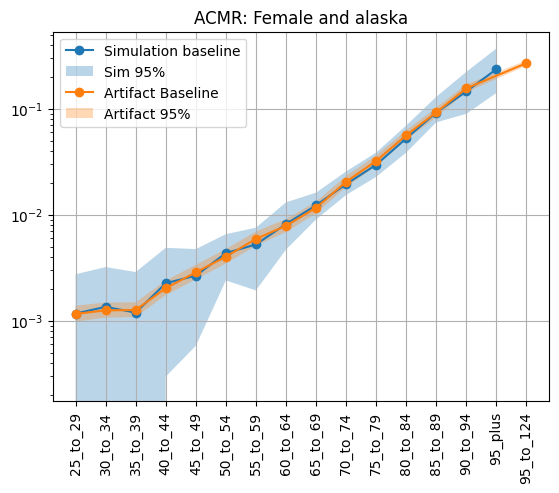

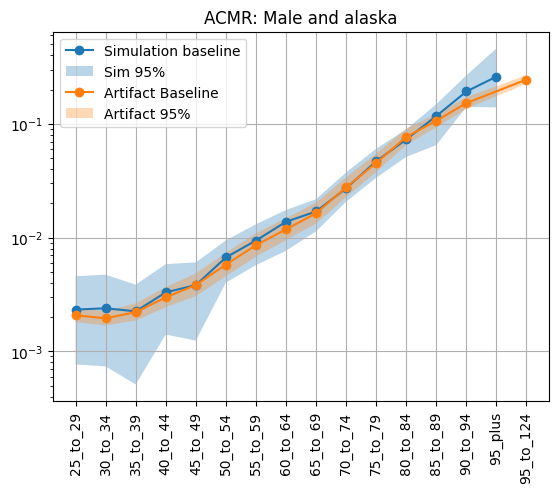

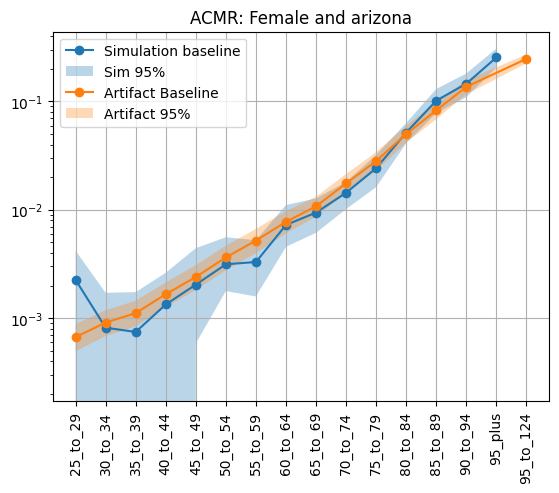

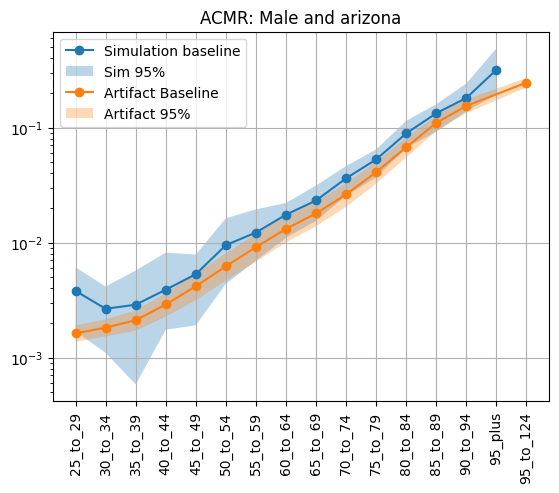

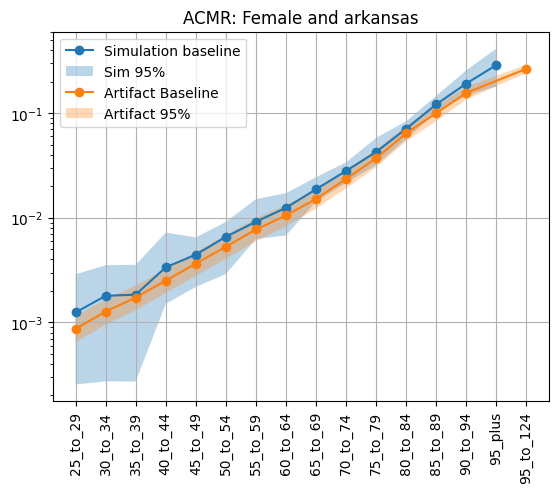

...

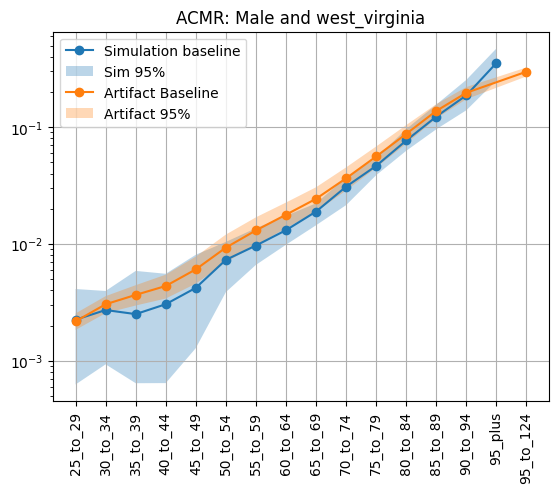

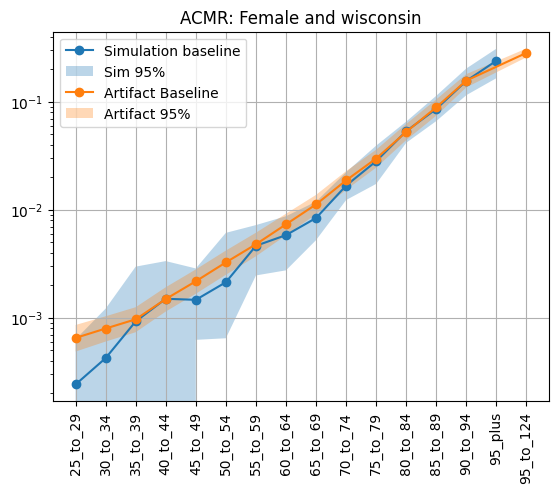

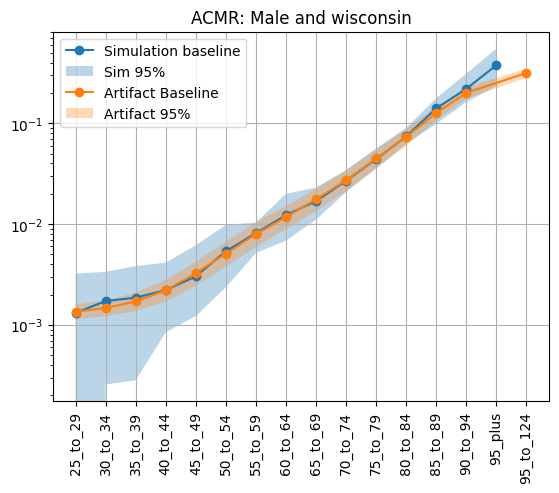

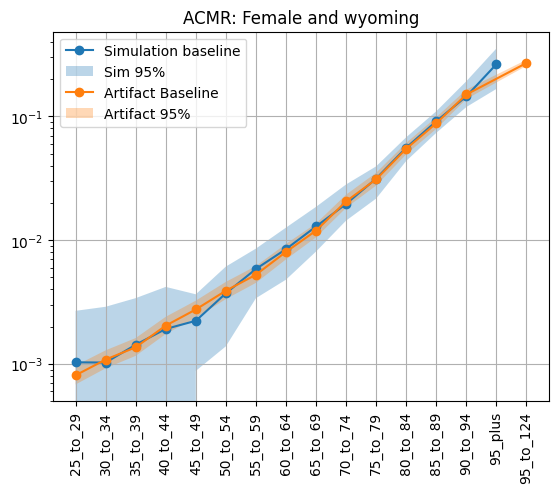

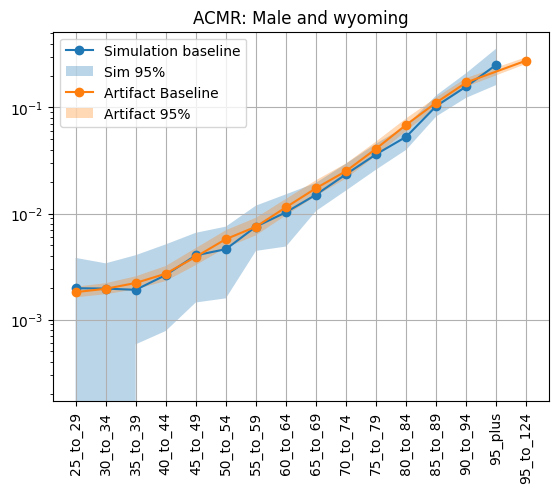

In [45]:
with PdfPages('acmr_51_locations_08042023.pdf') as pdf:
    for location in result_summary_allyears.location.unique():
        for sex in result_summary_allyears.sex.unique():
            plt.figure() 
            subdata = result_summary_allyears.loc[(result_summary_allyears.location==location) & (result_summary_allyears.sex==sex)]
            plt.plot(subdata['age'], subdata['mean'], marker='o')
            plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
            subdata2 = art_acmr.loc[(art_acmr.location==location) & (art_acmr.sex==sex)]
            plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
            plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
            plt.title(f'ACMR: {sex} and {location}') 
            plt.xticks(rotation=90) 
            plt.grid()
            plt.yscale('log')
            plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 
            pdf.savefig(bbox_inches='tight')

### Cause Specific Mortality Rates

#### Stroke

In [46]:
art_csmr = load_artifact_data('cause', 'ischemic_stroke', 'cause_specific_mortality_rate') 
art_csmr['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_acmr.age_start,art_acmr.age_end)]
art_csmr.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,7.816925e-07,4.301786e-07,0.000001,washington,cause_specific_mortality_rate,25_to_29
1,Female,30.0,35.0,2019,2020,1.256581e-06,7.000403e-07,0.000002,washington,cause_specific_mortality_rate,30_to_34
2,Female,35.0,40.0,2019,2020,2.084190e-06,1.223582e-06,0.000003,washington,cause_specific_mortality_rate,35_to_39
3,Female,40.0,45.0,2019,2020,4.072708e-06,2.621211e-06,0.000006,washington,cause_specific_mortality_rate,40_to_44
4,Female,45.0,50.0,2019,2020,6.687930e-06,4.062284e-06,0.000010,washington,cause_specific_mortality_rate,45_to_49


In [47]:
acute_rate_sum_allyear = (acute_rate_2.loc[acute_rate_2.scenario=='baseline']
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

In [48]:
chronic_rate_allyear = (chronic_rate.loc[chronic_rate.scenario=='baseline']
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

In [49]:
acute_rate_2 = acute_rate_2.rename(columns = {'mean_rate':'acute_rate'})
chronic_rate = chronic_rate.rename(columns = {'mean_rate':'chronic_rate'})
total_stroke_rate = pd.concat([acute_rate_2, chronic_rate.chronic_rate], axis=1)
total_stroke_rate['total_rate'] = total_stroke_rate['acute_rate'] + total_stroke_rate['chronic_rate']

In [50]:
total_stroke_rate_allyear = (total_stroke_rate
                      .groupby(['age', 'sex','location'])
                      .total_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())
total_stroke_rate_allyear.head()

,age,sex,location,mean,2.5%,97.5%
0,25_to_29,Female,alaska,0.000000,0.0,0.000000
1,25_to_29,Female,arizona,0.000028,0.0,0.000568
2,25_to_29,Female,arkansas,0.000000,0.0,0.000000
3,25_to_29,Female,california,0.000000,0.0,0.000000
4,25_to_29,Female,colorado,0.000029,0.0,0.000576


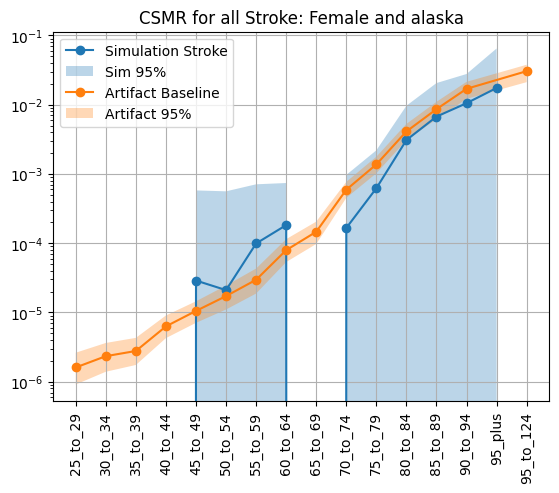

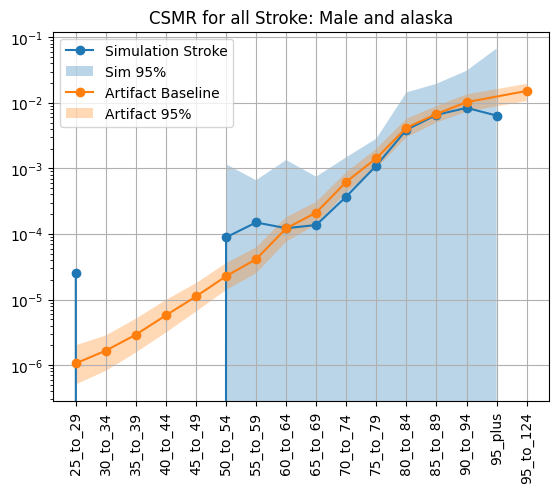

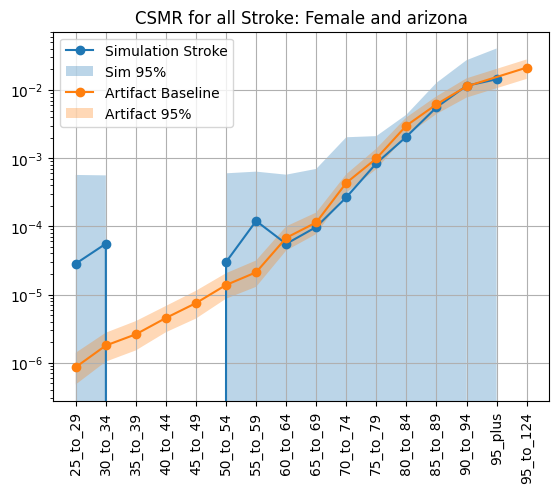

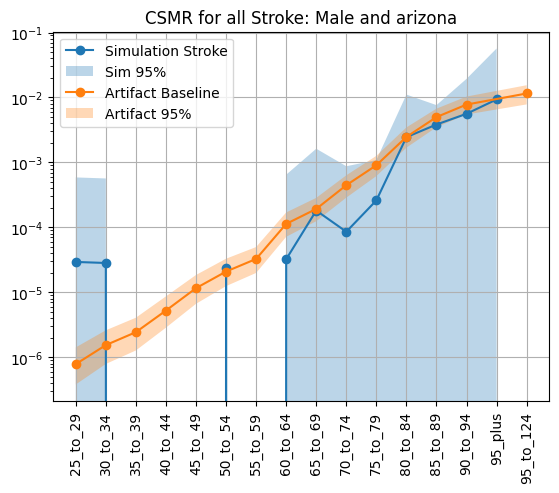

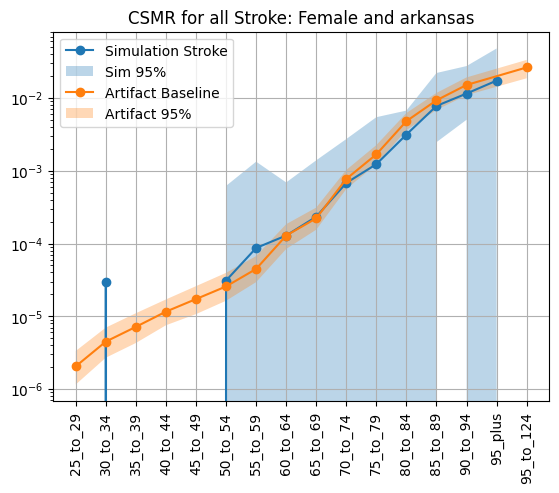

...

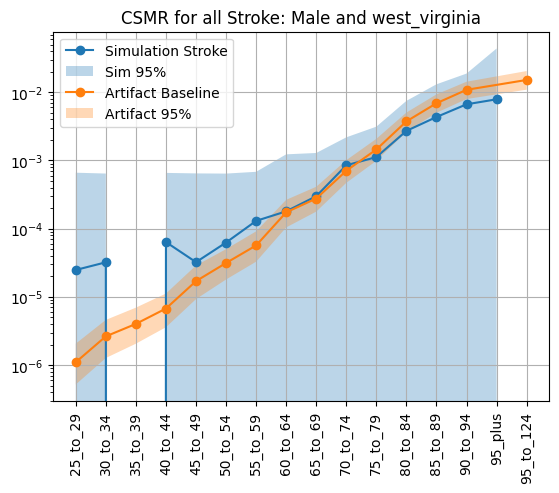

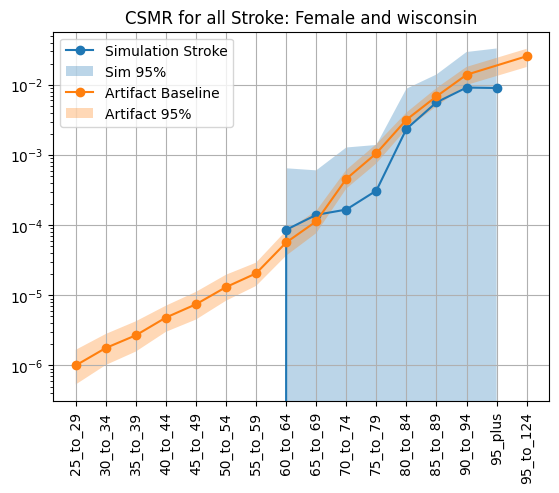

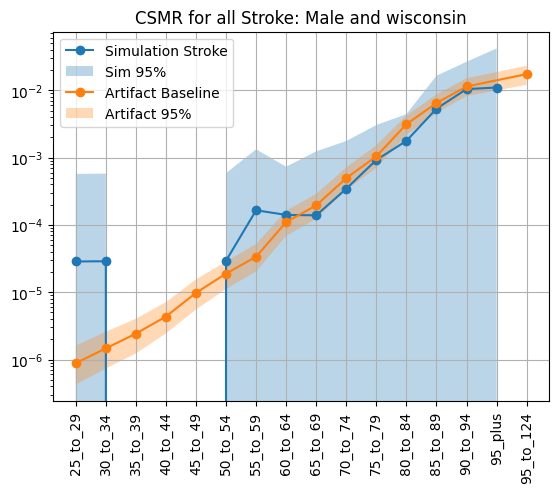

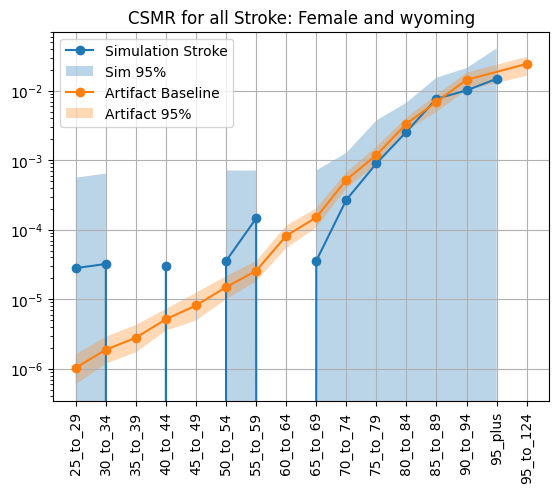

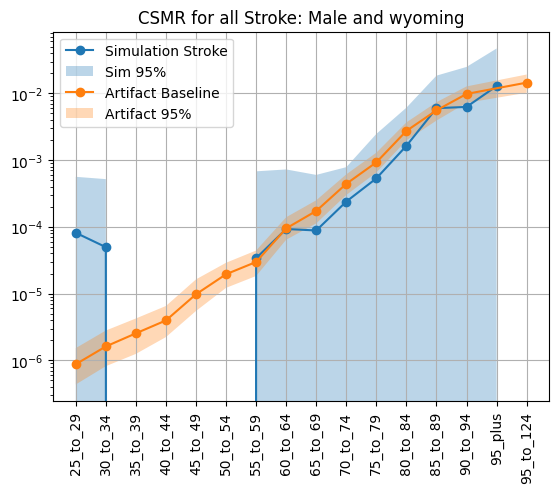

In [51]:
for location in acute_rate_sum_allyear.location.unique():
    for sex in acute_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata4 = total_stroke_rate_allyear.loc[(total_stroke_rate_allyear.location==location) & (total_stroke_rate_allyear.sex==sex)]
        plt.plot(subdata4['age'], subdata4['mean'], marker='o')
        plt.fill_between(subdata4['age'], subdata4['2.5%'], subdata4['97.5%'], alpha=.3)
        subdata3 = art_csmr.loc[(art_csmr.location==location) & (art_csmr.sex==sex)]
        plt.plot(subdata3['age_group'], subdata3['mean'], marker='o')
        plt.fill_between(subdata3['age_group'], subdata3['2.5%'], subdata3['97.5%'], alpha=.3)
        plt.title(f'CSMR for all Stroke: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.yscale('log')
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation Stroke', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 
        plt.show()

#### IHD and HF Combined

In [52]:
art_csmr2 = load_artifact_data('cause', 'ischemic_heart_disease_and_heart_failure', 'cause_specific_mortality_rate') 
art_csmr2['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_csmr2.age_start,art_csmr2.age_end)]
art_csmr2.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,0.000392,0.000284,0.000525,washington,cause_specific_mortality_rate,25_to_29
1,Female,30.0,35.0,2019,2020,0.000475,0.000340,0.000624,washington,cause_specific_mortality_rate,30_to_34
2,Female,35.0,40.0,2019,2020,0.000544,0.000390,0.000733,washington,cause_specific_mortality_rate,35_to_39
3,Female,40.0,45.0,2019,2020,0.000522,0.000399,0.000668,washington,cause_specific_mortality_rate,40_to_44
4,Female,45.0,50.0,2019,2020,0.000821,0.000667,0.001001,washington,cause_specific_mortality_rate,45_to_49


In [53]:
IHD_HF_CSMR = death_rate_cause.loc[(death_rate_cause['cause'] == 'acute_myocardial_infarction') | (death_rate_cause['cause'] == 'acute_myocardial_infarction_and_heart_failure') | (death_rate_cause['cause'] == 'heart_failure_from_ischemic_heart_disease') | (death_rate_cause['cause'] == 'heart_failure_residual') | (death_rate_cause['cause'] == 'post_myocardial_infarction')].reset_index()
IHD_HF_CSMR = IHD_HF_CSMR.groupby(['age','sex','year','input_draw','location']).value.sum().reset_index()
IHD_HF_CSMR = IHD_HF_CSMR.merge(per_time_group[['age','sex','year','input_draw','ptvalue','location']], on=['age','sex','year','input_draw','location'])
IHD_HF_CSMR['mean_rate'] = IHD_HF_CSMR['value'] / IHD_HF_CSMR['ptvalue']
IHD_HF_CSMR_allyear = (IHD_HF_CSMR
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())
IHD_HF_CSMR_allyear.head()

,age,sex,location,mean,2.5%,97.5%
0,25_to_29,Female,alaska,0.001877,0.0,0.007195
1,25_to_29,Female,arizona,0.008180,0.0,0.015620
2,25_to_29,Female,arkansas,0.003593,0.0,0.009308
3,25_to_29,Female,california,0.001401,0.0,0.004535
4,25_to_29,Female,colorado,0.003438,0.0,0.007679


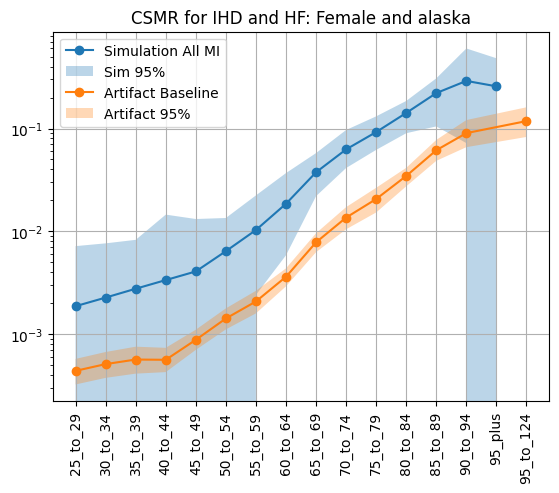

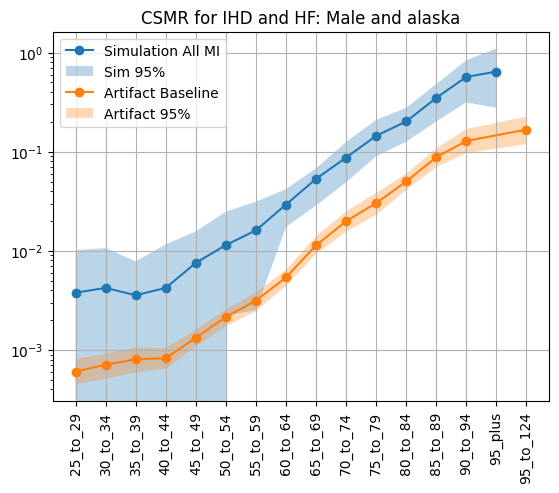

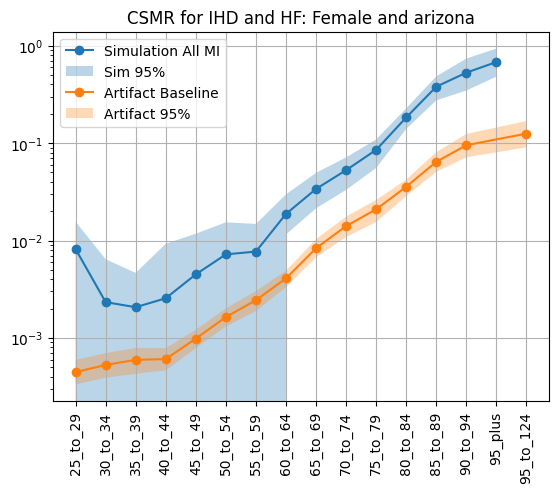

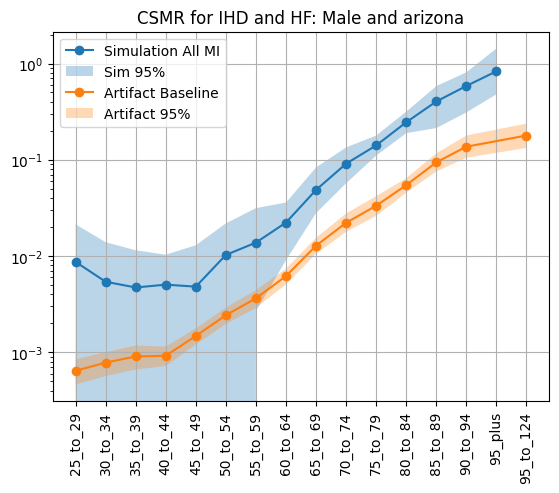

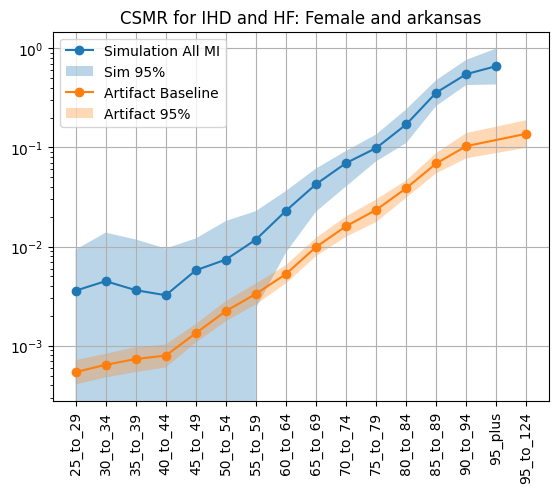

...

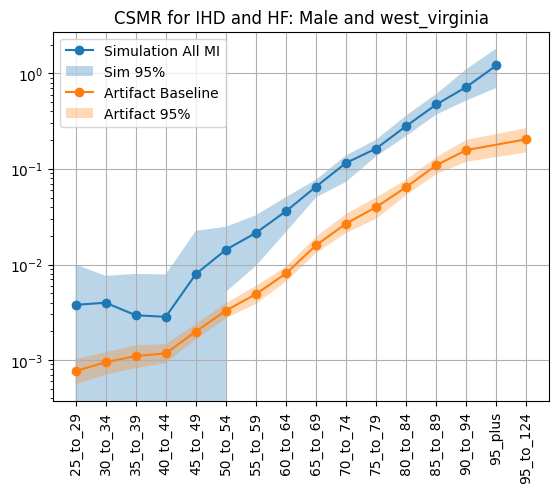

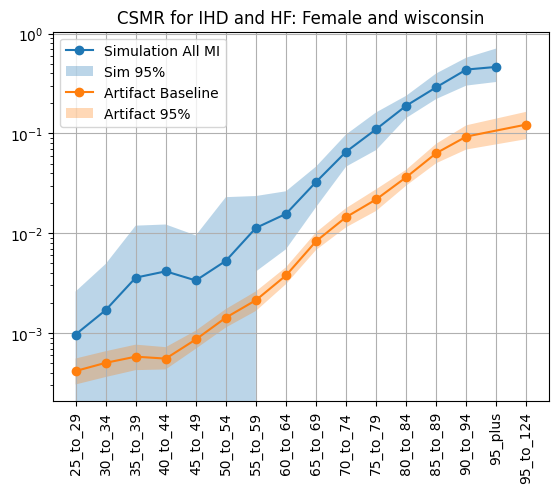

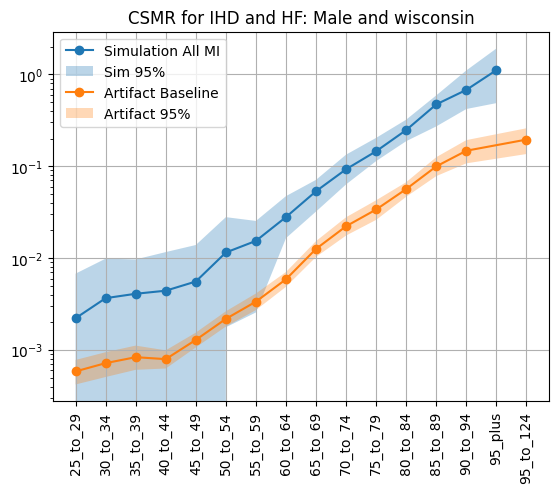

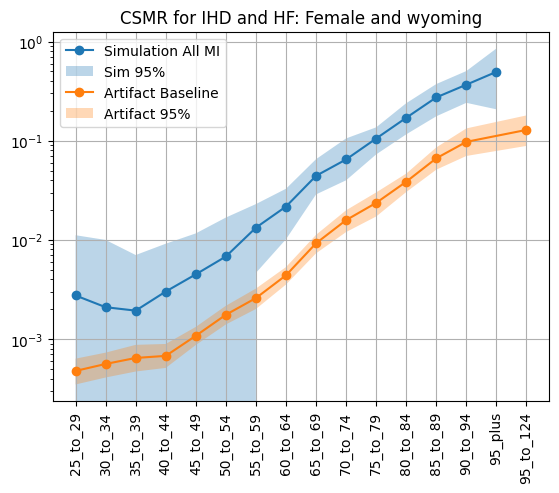

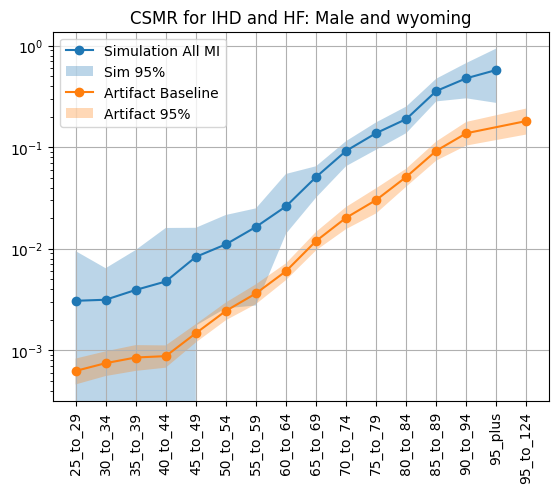

In [54]:
for location in IHD_HF_CSMR_allyear.location.unique():
    for sex in IHD_HF_CSMR_allyear.sex.unique():
        plt.figure() 
        subdata = IHD_HF_CSMR_allyear.loc[(IHD_HF_CSMR_allyear.location==location) & (IHD_HF_CSMR_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata3 = art_csmr2.loc[(art_csmr2.location==location) & (art_csmr2.sex==sex)]
        plt.plot(subdata3['age_group'], subdata3['mean'], marker='o')
        plt.fill_between(subdata3['age_group'], subdata3['2.5%'], subdata3['97.5%'], alpha=.3)
        plt.title(f'CSMR for IHD and HF: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation All MI', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Incidence Rates for Stroke

In [55]:
art_inc = load_artifact_data('cause', 'ischemic_stroke', 'incidence_rate')
art_inc['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_inc.age_start,art_inc.age_end)]
art_inc.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,0.000101,0.000040,0.000212,washington,incidence_rate,25_to_29
1,Female,30.0,35.0,2019,2020,0.000140,0.000074,0.000247,washington,incidence_rate,30_to_34
2,Female,35.0,40.0,2019,2020,0.000196,0.000099,0.000335,washington,incidence_rate,35_to_39
3,Female,40.0,45.0,2019,2020,0.000300,0.000183,0.000454,washington,incidence_rate,40_to_44
4,Female,45.0,50.0,2019,2020,0.000454,0.000249,0.000747,washington,incidence_rate,45_to_49


In [56]:
tran_rate_sum_allyear = (tran_rate.loc[tran_rate.scenario=='baseline']
                 .groupby(['age', 'sex', 'year','location'])
                 .rate.describe(percentiles=[.025, 0.5, .975])
                 .filter(['50%', '2.5%', '97.5%'])
                 .reset_index())
tran_rate_sum_allyear.head()

,age,sex,year,location,50%,2.5%,97.5%
0,25_to_29,Female,2021,alaska,0.000524,0.000524,0.000524
1,25_to_29,Female,2021,arizona,0.003599,0.003599,0.003599
2,25_to_29,Female,2021,arkansas,0.000537,0.000537,0.000537
3,25_to_29,Female,2021,california,0.001904,0.001904,0.001904
4,25_to_29,Female,2021,colorado,0.000527,0.000527,0.000527


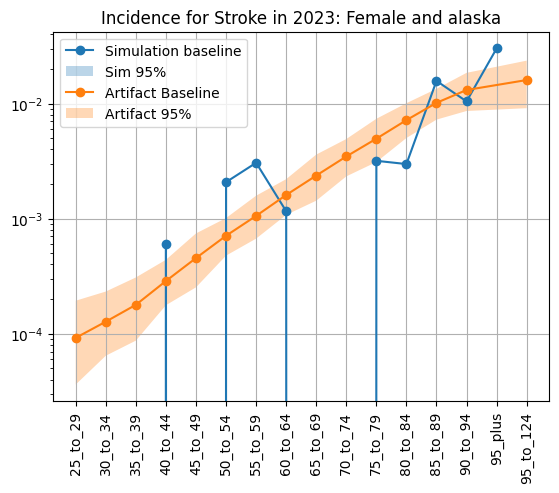

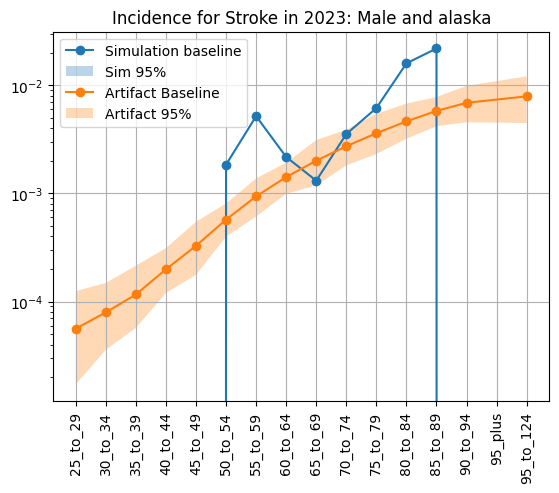

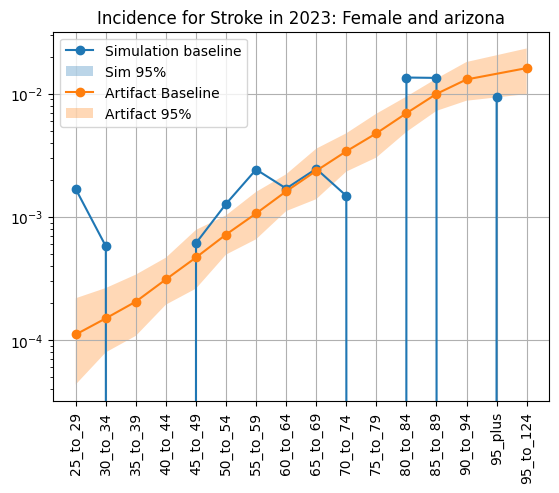

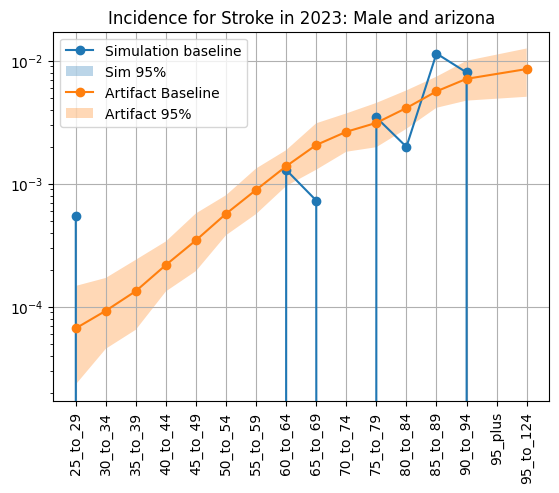

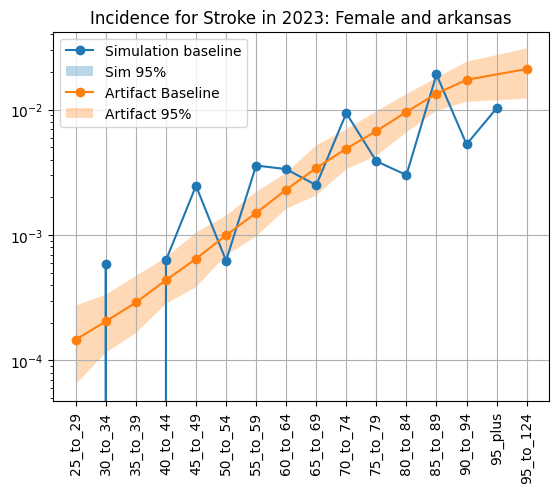

...

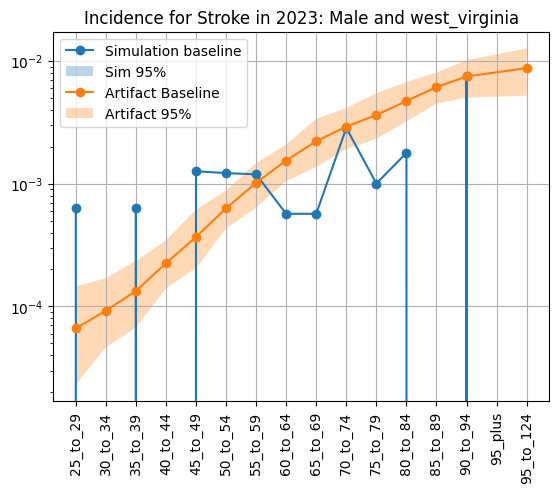

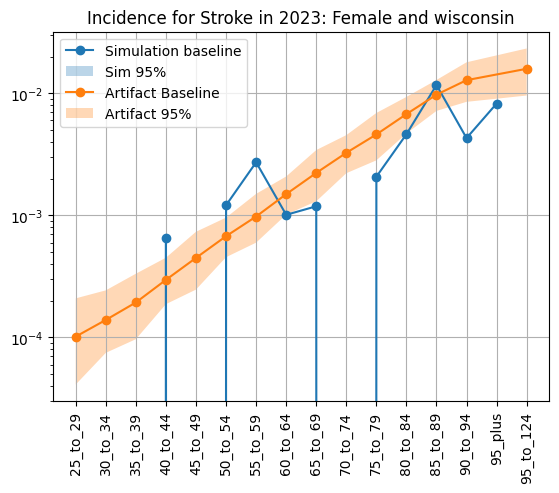

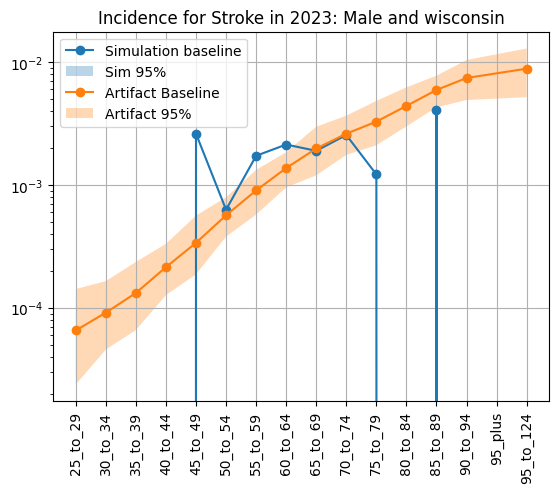

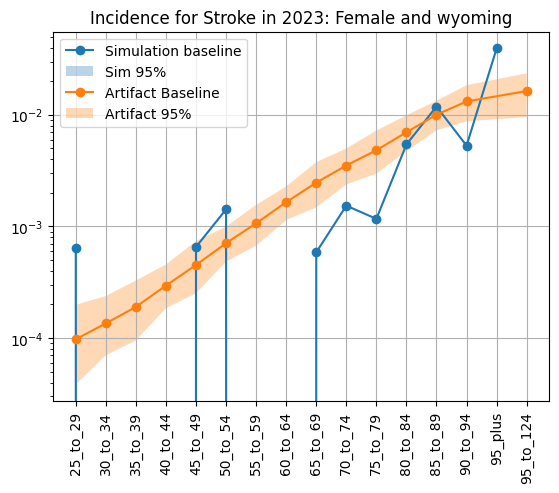

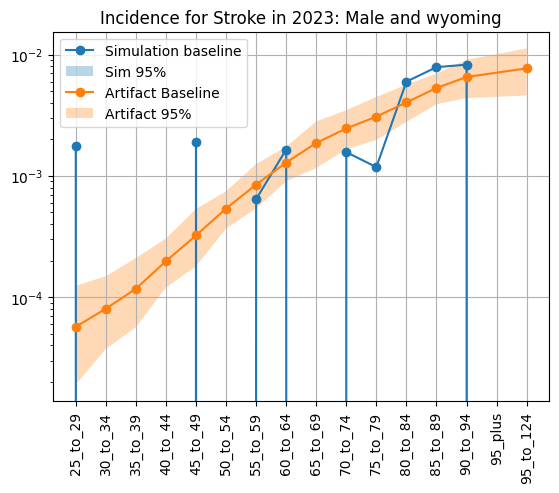

In [57]:
for location in tran_rate_sum_allyear.location.unique():
    for sex in tran_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata = tran_rate_sum_allyear.loc[(tran_rate_sum_allyear.location==location) & (tran_rate_sum_allyear.sex==sex) & (tran_rate_sum_allyear.year==2023)]
        plt.plot(subdata['age'], subdata['50%'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_inc.loc[(art_inc.location==location) & (art_inc.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Incidence for Stroke in 2023: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

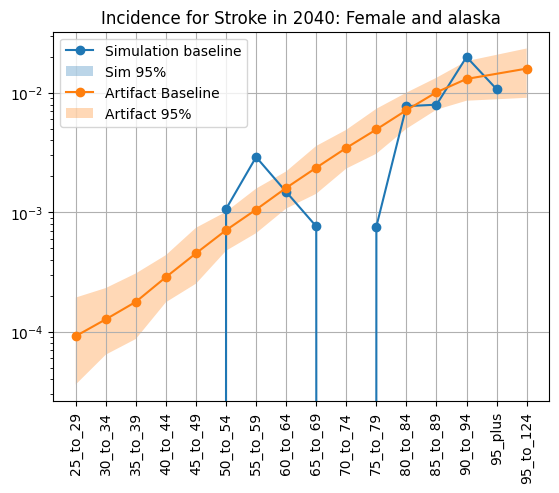

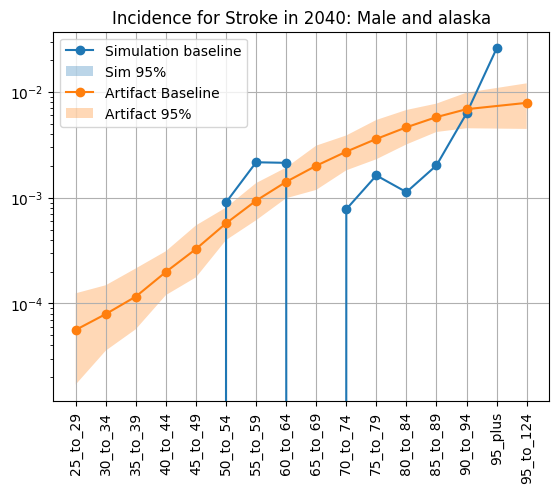

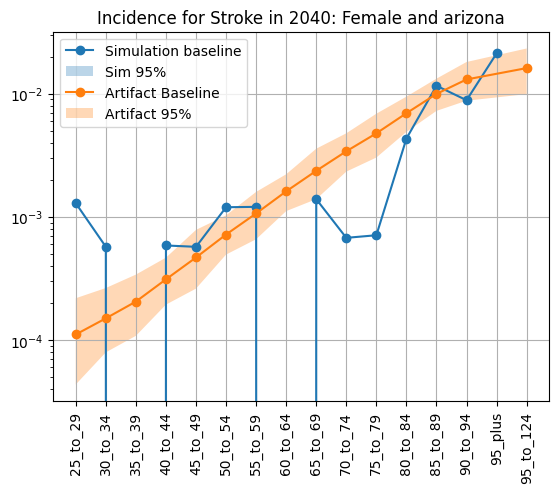

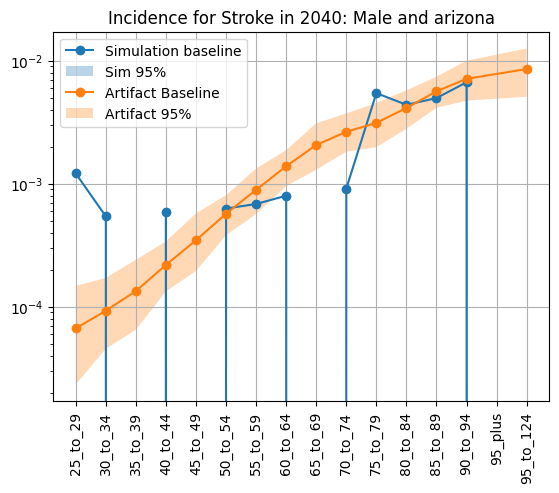

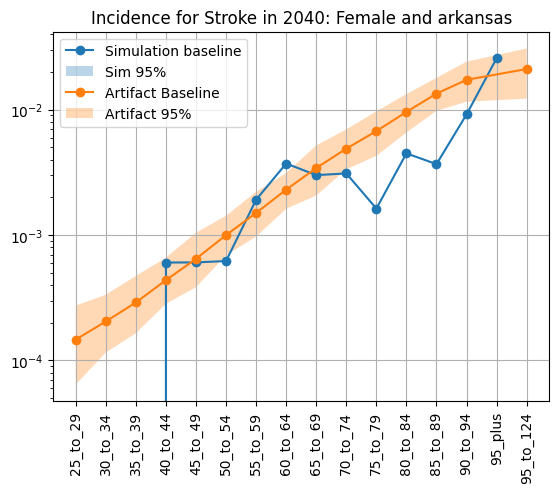

...

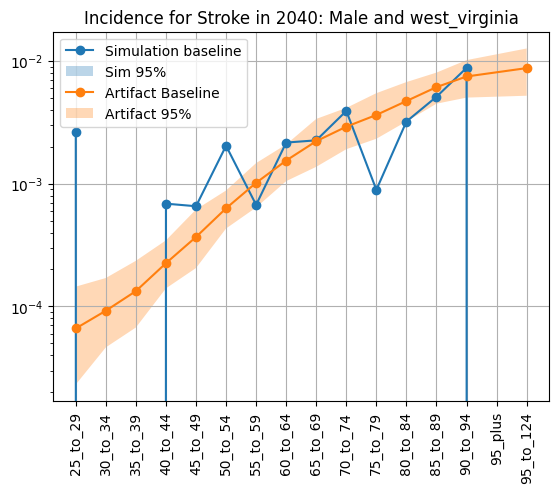

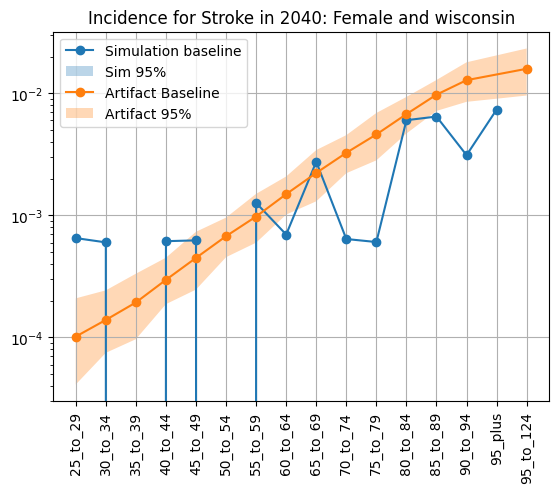

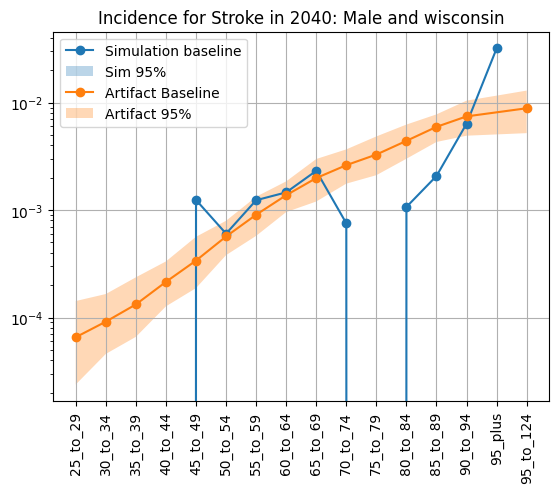

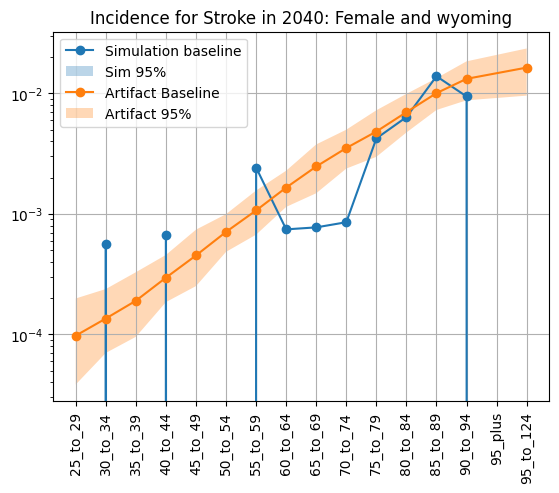

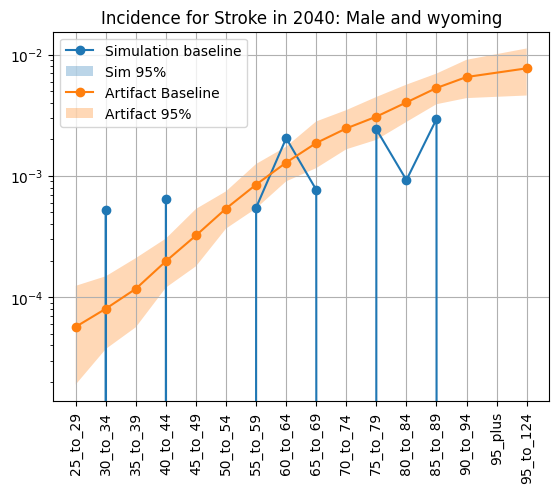

In [58]:
for location in tran_rate_sum_allyear.location.unique():
    for sex in tran_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata = tran_rate_sum_allyear.loc[(tran_rate_sum_allyear.location==location) & (tran_rate_sum_allyear.sex==sex) & (tran_rate_sum_allyear.year==2040)]
        plt.plot(subdata['age'], subdata['50%'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_inc.loc[(art_inc.location==location) & (art_inc.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Incidence for Stroke in 2040: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Incidence Rates for MI

In [59]:
art_inc_acute_MI = load_artifact_data('cause', 'acute_myocardial_infarction', 'incidence_rate')
art_inc_acute_MI['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_inc_acute_MI.age_start,art_inc_acute_MI.age_end)]
art_inc_acute_MI.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,0.000403,0.000254,0.000570,washington,incidence_rate,25_to_29
1,Female,30.0,35.0,2019,2020,0.000444,0.000295,0.000605,washington,incidence_rate,30_to_34
2,Female,35.0,40.0,2019,2020,0.000346,0.000240,0.000478,washington,incidence_rate,35_to_39
3,Female,40.0,45.0,2019,2020,0.000410,0.000307,0.000538,washington,incidence_rate,40_to_44
4,Female,45.0,50.0,2019,2020,0.000637,0.000480,0.000820,washington,incidence_rate,45_to_49


In [60]:
groupby_cols2 = ['age', 'sex', 'input_draw','location']
tran_rate_MI_all = tran_rate_MI.loc[tran_rate_MI.scenario=='baseline'].groupby(groupby_cols2).sum() / per_time_sus_MI.loc[per_time_sus_MI.scenario=='baseline'].groupby(groupby_cols2).sum()
tran_MI_summ_allyear = (tran_rate_MI_all.groupby([c for c in groupby_cols2 if c != 'input_draw'])
                   .value.describe(percentiles=[0.025, 0.5, 0.975])
                   .filter(['mean','50%', '2.5%', '97.5%']))
                 
tran_MI_summ_allyear.head()

mean       50%      2.5%     97.5%
age      sex    location                                          
25_to_29 Female alaska      0.000761  0.000761  0.000761  0.000761
                arizona     0.004543  0.004543  0.004543  0.004543
                arkansas    0.001796  0.001796  0.001796  0.001796
                california  0.001335  0.001335  0.001335  0.001335
                colorado    0.002631  0.002631  0.002631  0.002631

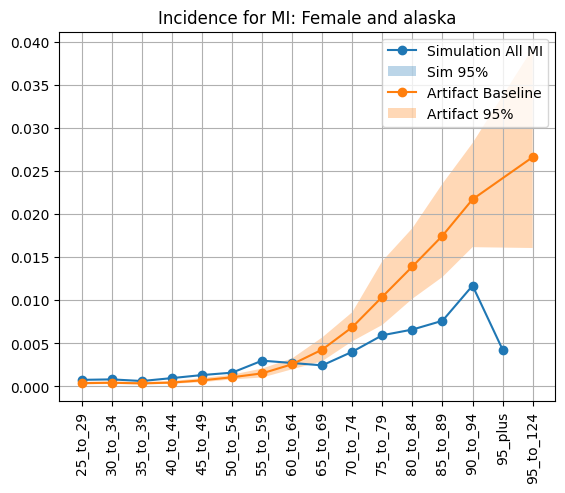

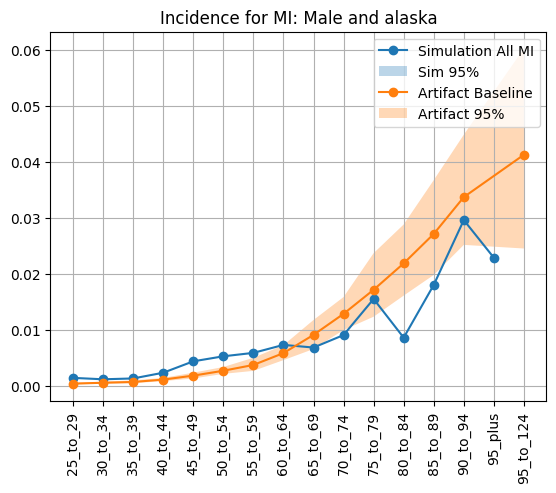

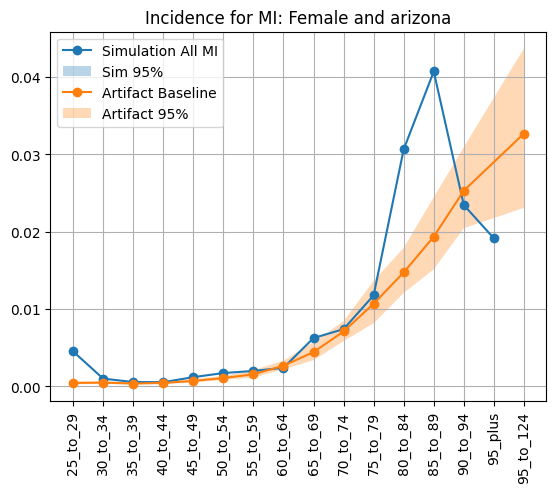

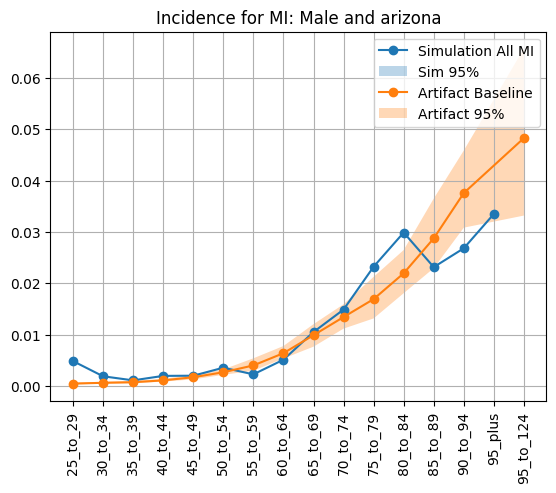

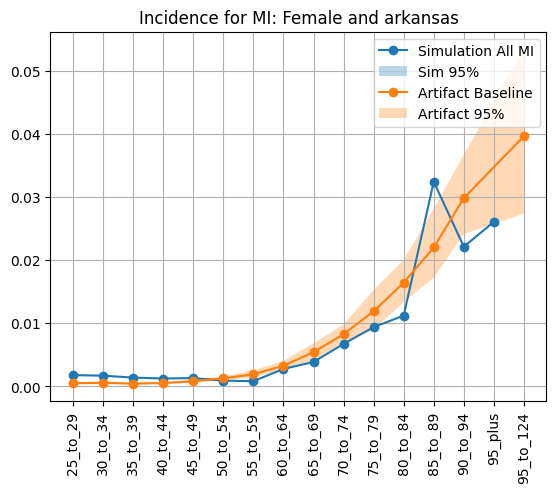

...

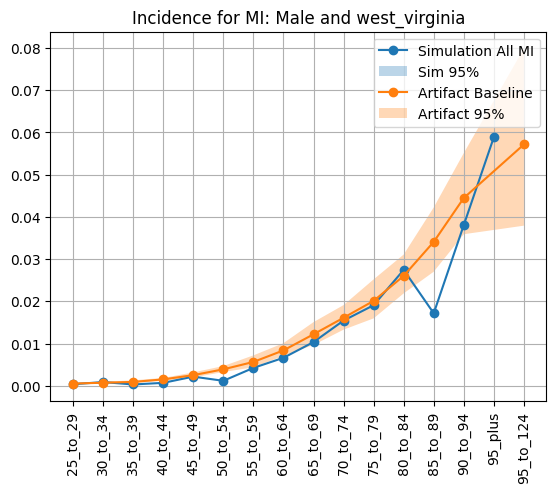

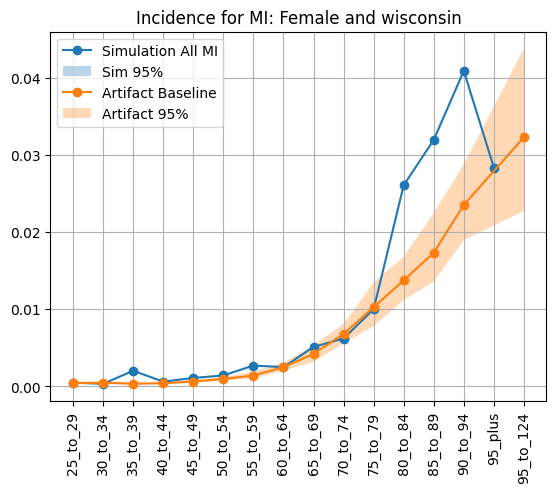

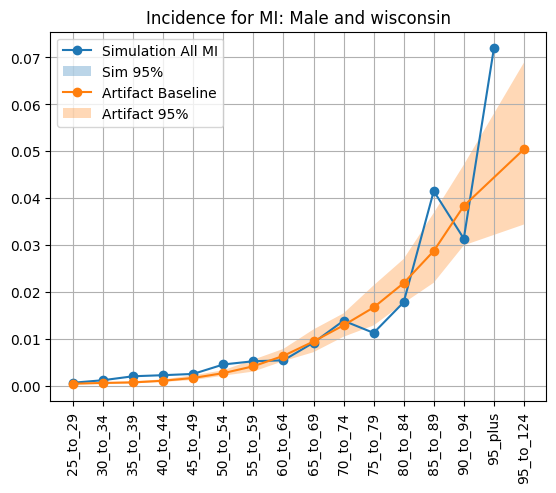

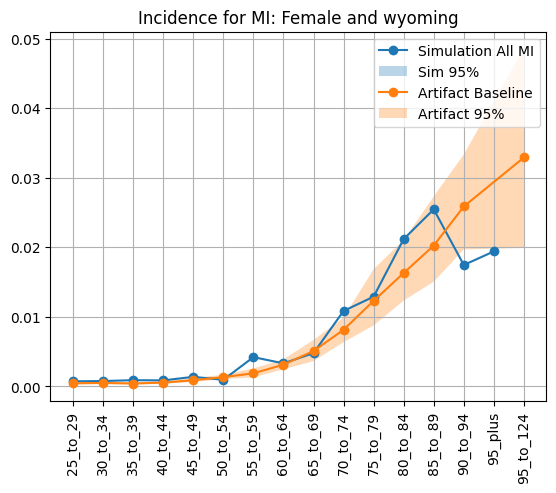

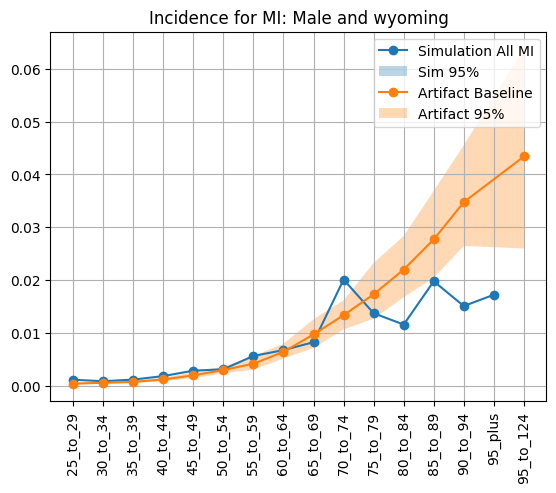

In [61]:
with PdfPages('MI_inc_51_locations_08042023.pdf') as pdf:
    for location in tran_MI_summ_allyear.index.get_level_values('location').unique():
        for sex in tran_MI_summ_allyear.index.get_level_values('sex').unique():
            plt.figure() 
            subdata = tran_MI_summ_allyear.loc[(tran_MI_summ_allyear.index.get_level_values('location')==location)&(tran_MI_summ_allyear.index.get_level_values('sex')==sex)]
            plt.plot(subdata.index.get_level_values('age'), subdata['50%'], marker='o')
            plt.fill_between(subdata.index.get_level_values('age'), subdata['2.5%'], subdata['97.5%'], alpha=.3)
            subdata3 = art_inc_acute_MI.loc[(art_inc_acute_MI.location==location) & (art_inc_acute_MI.sex==sex)]
            plt.plot(subdata3['age_group'], subdata3['mean'], marker='o')
            plt.fill_between(subdata3['age_group'], subdata3['2.5%'], subdata3['97.5%'], alpha=.3)
            plt.title(f'Incidence for MI: {sex} and {location}') 
            plt.xticks(rotation=90) 
            plt.grid()
            #plt.yscale('log')
            plt.legend(['Simulation All MI', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 
            plt.show()
            #pdf.savefig(bbox_inches='tight')

### Incidence Rates for Heart Failure IHD

In [62]:
art_inc_HF_IHD = load_artifact_data('cause', 'heart_failure_from_ischemic_heart_disease', 'incidence_rate')
art_inc_HF_IHD['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_inc_HF_IHD.age_start,art_inc_HF_IHD.age_end)]
art_inc_HF_IHD.head()

,sex,age_start,age_end,year_start,year_end,mean,2.5%,97.5%,location,measure,age_group
0,Female,25.0,30.0,2019,2020,0.000038,0.000027,0.000051,washington,incidence_rate,25_to_29
1,Female,30.0,35.0,2019,2020,0.000051,0.000037,0.000066,washington,incidence_rate,30_to_34
2,Female,35.0,40.0,2019,2020,0.000045,0.000029,0.000066,washington,incidence_rate,35_to_39
3,Female,40.0,45.0,2019,2020,0.000072,0.000054,0.000097,washington,incidence_rate,40_to_44
4,Female,45.0,50.0,2019,2020,0.000220,0.000178,0.000266,washington,incidence_rate,45_to_49


In [63]:
per_time_sus_HF = person_time.loc[(person_time['state'].isin(['susceptible_to_ischemic_heart_disease_and_heart_failure','post_myocardial_infarction','acute_myocardial_infarction_and_heart_failure']))].reset_index()
tran_rate_HF_IHD = tran.loc[(tran['transition'].isin(['acute_myocardial_infarction_and_heart_failure_to_heart_failure_from_ischemic_heart_disease','post_myocardial_infarction_to_heart_failure_from_ischemic_heart_disease','susceptible_to_ischemic_heart_disease_and_heart_failure_to_heart_failure_from_ischemic_heart_disease']))].reset_index()
groupby_cols = ['age', 'sex', 'input_draw','scenario','location']
tran_rate_HF_IHD = tran_rate_HF_IHD.groupby(groupby_cols).sum() / per_time_sus_HF.groupby(groupby_cols).sum()
tran_rate_HF_IHD_allyear = (tran_rate_HF_IHD.groupby([c for c in groupby_cols if c != 'input_draw'])
                   .value.describe(percentiles=[0.025, 0.975])
                   .filter(['mean', '2.5%', '97.5%']))
                 
tran_rate_HF_IHD_allyear = tran_rate_HF_IHD_allyear.loc[tran_rate_HF_IHD_allyear.index.get_level_values('scenario')=='baseline']
tran_rate_HF_IHD_allyear.head()

mean      2.5%     97.5%
age      sex    scenario location                                
25_to_29 Female baseline alaska      0.000000  0.000000  0.000000
                         arizona     0.000000  0.000000  0.000000
                         arkansas    0.000058  0.000058  0.000058
                         california  0.000116  0.000116  0.000116
                         colorado    0.000030  0.000030  0.000030

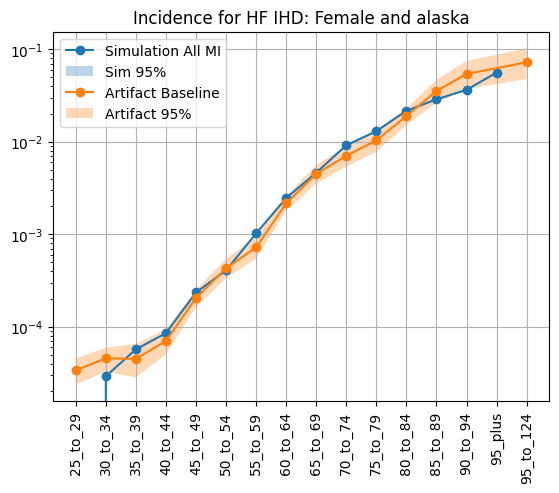

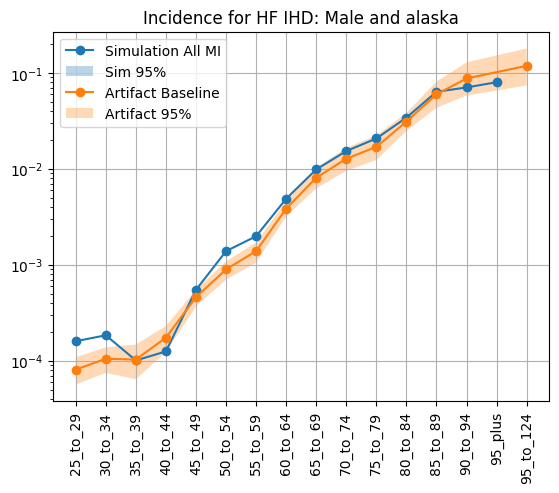

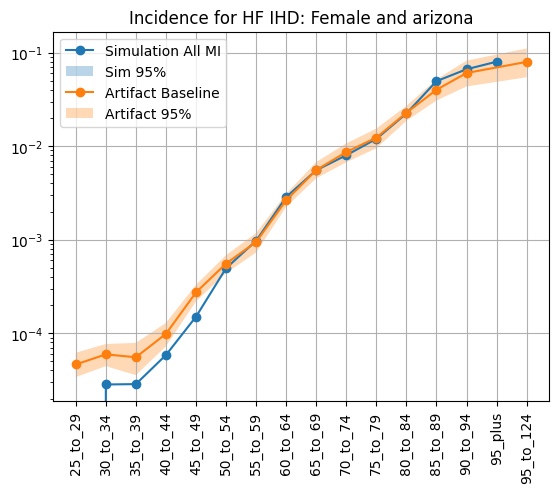

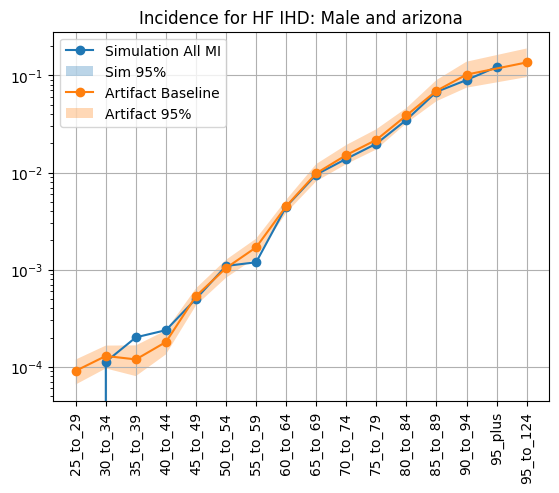

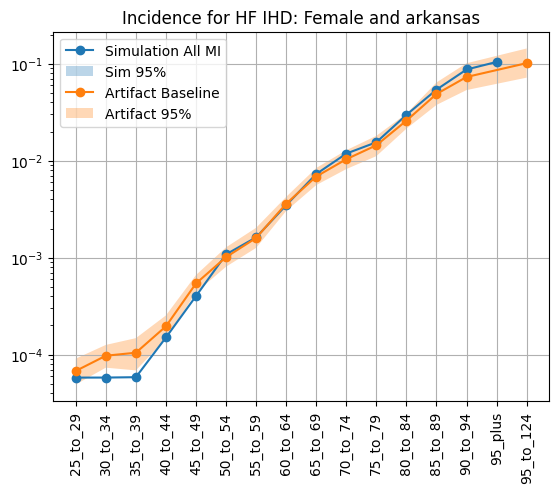

...

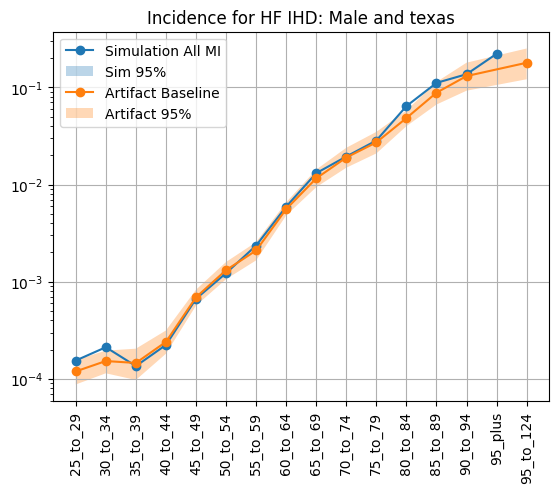

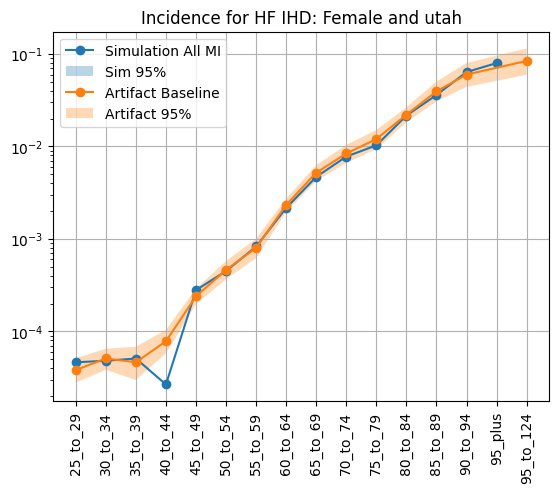

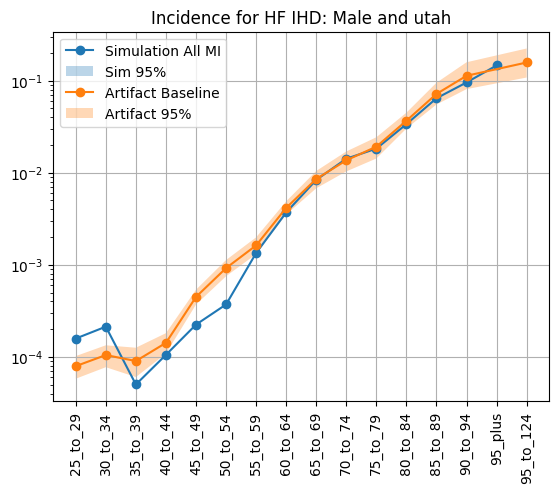

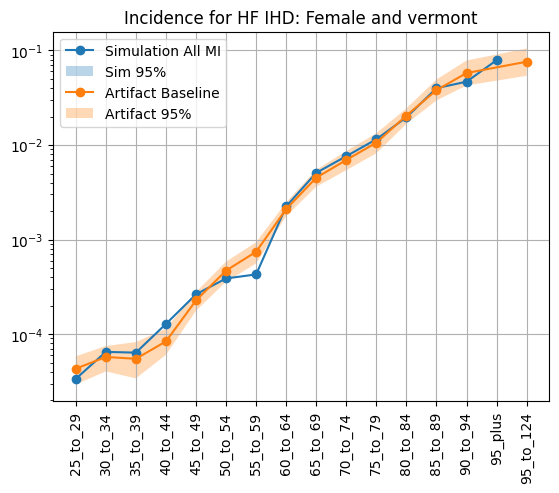

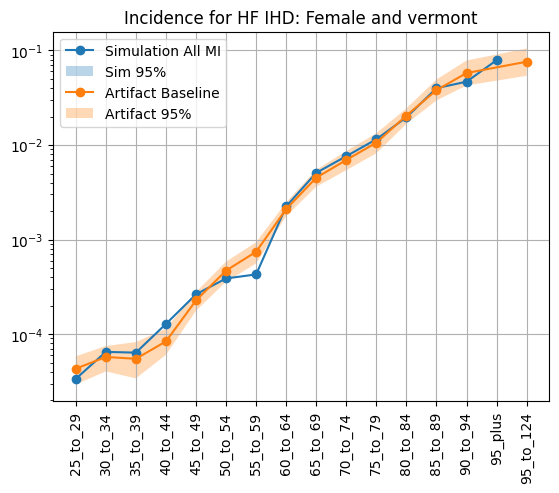

In [64]:
for location in tran_rate_HF_IHD_allyear.index.get_level_values('location').unique():
    for sex in tran_rate_HF_IHD_allyear.index.get_level_values('sex').unique():
        plt.figure() 
        subdata = tran_rate_HF_IHD_allyear.loc[(tran_rate_HF_IHD_allyear.index.get_level_values('location')==location) & (tran_rate_HF_IHD_allyear.index.get_level_values('sex')==sex)]
        plt.plot(subdata.index.get_level_values('age'), subdata['mean'], marker='o')
        plt.fill_between(subdata.index.get_level_values('age'), subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata3 = art_inc_HF_IHD.loc[(art_inc_HF_IHD.location==location) & (art_inc_HF_IHD.sex==sex)]
        plt.plot(subdata3['age_group'], subdata3['mean'], marker='o')
        plt.fill_between(subdata3['age_group'], subdata3['2.5%'], subdata3['97.5%'], alpha=.3)
        plt.title(f'Incidence for HF IHD: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation All MI', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### Incidence Rates for Heart Failure Residual

In [65]:
art_inc_HF_resid = load_artifact_data('cause', 'heart_failure_residual', 'incidence_rate')
art_inc_HF_resid['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_inc_HF_resid.age_start,art_inc_HF_resid.age_end)]
art_inc_HF_resid.head()

In [66]:
per_time_sus_HF = person_time.loc[(person_time['state'].isin(['susceptible_to_ischemic_heart_disease_and_heart_failure']))].reset_index()
tran_rate_HF_resid = tran.loc[(tran['transition'].isin(['susceptible_to_ischemic_heart_disease_and_heart_failure_to_heart_failure_residual']))].reset_index()
groupby_cols = ['age', 'sex', 'input_draw','scenario','location']
tran_rate_HF_resid = tran_rate_HF_resid.groupby(groupby_cols).sum() / per_time_sus_HF.groupby(groupby_cols).sum()
tran_rate_HF_resid_allyear = (tran_rate_HF_resid.groupby([c for c in groupby_cols if c != 'input_draw'])
                   .value.describe(percentiles=[0.025, 0.975])
                   .filter(['mean', '2.5%', '97.5%']))
                 
tran_rate_HF_resid_allyear = tran_rate_HF_resid_allyear.loc[tran_rate_HF_resid_allyear.index.get_level_values('scenario')=='baseline']
tran_rate_HF_resid_allyear.head()

In [67]:
with PdfPages('HF_incidence_10_locations_08042023.pdf') as pdf:
    for location in tran_rate_HF_resid_allyear.index.get_level_values('location').unique():
        for sex in tran_rate_HF_resid_allyear.index.get_level_values('sex').unique():
            plt.figure() 
            subdata = tran_rate_HF_resid_allyear.loc[(tran_rate_HF_resid_allyear.index.get_level_values('location')==location) & (tran_rate_HF_resid_allyear.index.get_level_values('sex')==sex)]
            plt.plot(subdata.index.get_level_values('age'), subdata['mean'], marker='o')
            plt.fill_between(subdata.index.get_level_values('age'), subdata['2.5%'], subdata['97.5%'], alpha=.3)
            subdata3 = art_inc_HF_resid.loc[(art_inc_HF_resid.location==location) & (art_inc_HF_resid.sex==sex)]
            plt.plot(subdata3['age_group'], subdata3['mean'], marker='o')
            plt.fill_between(subdata3['age_group'], subdata3['2.5%'], subdata3['97.5%'], alpha=.3)
            plt.title(f'Incidence for HF Resid: {sex} and {location}') 
            plt.xticks(rotation=90) 
            plt.grid()
            plt.yscale('log')
            plt.legend(['Simulation All MI', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

Matches the artifact but the artifact looks weird for the youngest folks 

#### Prevalence Rates

In [68]:
prev_chronic_rate_sum_allyear = (prev_chronic_rate.loc[prev_chronic_rate.scenario=='baseline']
                 .groupby(['age', 'sex','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

In [69]:
art_prev = load_artifact_data('sequela', 'chronic_ischemic_stroke', 'prevalence')
art_prev['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev.age_start,art_prev.age_end)]
art_prev.head()

In [70]:
for location in prev_chronic_rate_sum_allyear.location.unique():
    for sex in prev_chronic_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata = prev_chronic_rate_sum_allyear.loc[(prev_chronic_rate_sum_allyear.location==location) & (prev_chronic_rate_sum_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev.loc[(art_prev.location==location) & (art_prev.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of Chronic Stroke: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

In [71]:
prev_acute_rate_sum_allyear = (prev_acute_rate.loc[prev_acute_rate.scenario=='baseline']
                 .groupby(['age', 'sex','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

In [72]:
art_prev2 = load_artifact_data('sequela', 'acute_ischemic_stroke', 'prevalence')
art_prev2['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev2.age_start,art_prev2.age_end)]

In [73]:
for location in prev_acute_rate_sum_allyear.location.unique():
    for sex in prev_acute_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata = prev_acute_rate_sum_allyear.loc[(prev_acute_rate_sum_allyear.location==location) & (prev_acute_rate_sum_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev2.loc[(art_prev2.location==location) & (art_prev2.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of Acute Stroke: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Prevalence of Post MI

In [74]:
art_prev3 = load_artifact_data('cause', 'post_myocardial_infarction', 'prevalence')
art_prev3['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev3.age_start,art_prev3.age_end)]
art_prev3.head()

In [75]:
prev_post_MI_sum_allyear = (prev_post_MI.loc[prev_post_MI.scenario=='baseline']
                 .groupby(['age', 'sex', 'year','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_post_MI_sum_allyear.head()

In [76]:
##Can try plotting the median 

for location in prev_post_MI_sum_allyear.location.unique():
    for sex in prev_post_MI_sum_allyear.sex.unique():
        plt.figure() 
        subdata = prev_post_MI_sum_allyear.loc[(prev_post_MI_sum_allyear.location==location) & (prev_post_MI_sum_allyear.sex==sex) & (prev_post_MI_sum_allyear.year == 2023)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev3.loc[(art_prev3.location==location) & (art_prev3.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of Post MI: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

In [77]:
## 2023 looks pretty good but 2040 looks pretty bad 

#### Prevalence of Acute MI

In [78]:
art_prev4 = load_artifact_data('cause', 'acute_myocardial_infarction', 'prevalence')
art_prev4['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev4.age_start,art_prev4.age_end)]
art_prev4.head()

In [79]:
prev_acute_MI_sum_allyear = (prev_acute_MI.loc[prev_acute_MI.scenario=='baseline']
                 .groupby(['age', 'sex','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_acute_MI_sum_allyear.head()

In [80]:
for location in prev_acute_MI_sum_allyear.location.unique():
    for sex in prev_acute_MI_sum_allyear.sex.unique():
        plt.figure() 
        subdata = prev_acute_MI_sum_allyear.loc[(prev_acute_MI_sum_allyear.location==location) & (prev_acute_MI_sum_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev4.loc[(art_prev4.location==location) & (art_prev4.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of Acute MI: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### Prevalence of Heart Failure IHD

In [81]:
art_prev_hf_ihd = load_artifact_data('cause', 'heart_failure_from_ischemic_heart_disease', 'prevalence')
art_prev_hf_ihd['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev_hf_ihd.age_start,art_prev_hf_ihd.age_end)]
art_prev_hf_ihd.head()

In [82]:
prev_HF_IHD = per_time_state.loc[(per_time_state['state'] == 'heart_failure_from_ischemic_heart_disease')].reset_index()
prev_HF_IHD = prev_HF_IHD.rename(columns = {'ptvalue':'value'})
prev_HF_IHD = prev_HF_IHD.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
prev_HF_IHD['rate']= prev_HF_IHD['value'] / prev_HF_IHD['ptvalue']
prev_HF_IHD_allyear = (prev_HF_IHD
                 .groupby(['age', 'sex','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())
prev_HF_IHD_allyear = prev_HF_IHD_allyear.loc[prev_HF_IHD_allyear.scenario=='baseline']
prev_HF_IHD_allyear.head()

In [83]:
for location in prev_HF_IHD_allyear.location.unique():
    for sex in prev_HF_IHD_allyear.sex.unique():
        plt.figure() 
        subdata = prev_HF_IHD_allyear.loc[(prev_HF_IHD_allyear.location==location) & (prev_HF_IHD_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev_hf_ihd.loc[(art_prev_hf_ihd.location==location) & (art_prev_hf_ihd.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of HF IHD: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

## Prevalence of Heart Failure Residual

In [84]:
art_prev_hf_resid = load_artifact_data('cause', 'heart_failure_residual', 'prevalence')
art_prev_hf_resid['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_prev_hf_resid.age_start,art_prev_hf_resid.age_end)]
art_prev_hf_resid.head()

In [85]:
prev_HF_resid = per_time_state.loc[(per_time_state['state'] == 'heart_failure_residual')].reset_index()
prev_HF_resid = prev_HF_resid.rename(columns = {'ptvalue':'value'})
prev_HF_resid = prev_HF_resid.merge(per_time_group[['age','sex','year','input_draw','scenario','ptvalue','location']], on=['age','sex','year','input_draw','scenario','location'])
prev_HF_resid['rate']= prev_HF_resid['value'] / prev_HF_resid['ptvalue']
prev_HF_resid_allyear = (prev_HF_resid
                 .groupby(['age', 'sex','scenario','location'])
                 .rate.describe(percentiles=[.025, .975])
                 .filter(['mean', '2.5%', '97.5%'])
                 .reset_index())

prev_HF_resid_allyear = prev_HF_resid_allyear.loc[prev_HF_resid_allyear.scenario == 'baseline']
prev_HF_resid_allyear.head()

In [86]:
for location in prev_HF_resid_allyear.location.unique():
    for sex in prev_HF_resid_allyear.sex.unique():
        plt.figure() 
        subdata = prev_HF_resid_allyear.loc[(prev_HF_resid_allyear.location==location) & (prev_HF_resid_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_prev_hf_resid.loc[(art_prev_hf_resid.location==location) & (art_prev_hf_resid.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Prevalence of HF Residual: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

## Excess Mortality Rate

#### Acute Stroke

In [87]:
art_emr = load_artifact_data('sequela', 'acute_ischemic_stroke', 'excess_mortality_rate')
art_emr['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_emr.age_start,art_emr.age_end)]
art_emr.head()

In [88]:
prev_acute = per_time_state.loc[(per_time_state['state'] == 'acute_ischemic_stroke')].reset_index()
acute_rate_emr = pd.concat([acute_rate, prev_acute.ptvalue], axis=1)
acute_rate_emr['mean_rate'] = acute_rate_emr['value'] / acute_rate_emr['ptvalue']

acute_rate_sum_allyear = (acute_rate_emr
                      .groupby(['age', 'sex','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())
acute_rate_sum_allyear=acute_rate_sum_allyear.loc[acute_rate_sum_allyear.scenario=='baseline']
acute_rate_sum_allyear.head()

In [89]:
for location in acute_rate_sum_allyear.location.unique():
    for sex in acute_rate_sum_allyear.sex.unique():
        plt.figure() 
        subdata = acute_rate_sum_allyear.loc[(acute_rate_sum_allyear.location==location) & (acute_rate_sum_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_emr.loc[(art_emr.location==location) & (art_emr.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Excess Mortality Rate from Acute Stroke: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Chronic Stroke

In [90]:
art_emr2 = load_artifact_data('sequela', 'chronic_ischemic_stroke', 'excess_mortality_rate')
art_emr2['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_emr2.age_start,art_emr2.age_end)]

In [91]:
chronic = per_time_state.loc[(per_time_state['state'] == 'chronic_ischemic_stroke')].reset_index()
#chronic = chronic.rename(columns = {'value':'ptvalue'})
chronic_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'chronic_ischemic_stroke')].reset_index()
chronic_rate_emr = pd.concat([chronic_rate, chronic.ptvalue], axis=1)
chronic_rate_emr['mean_rate'] = chronic_rate_emr['value'] / chronic_rate_emr['ptvalue']
chronic_rate_emr_allyear = (chronic_rate_emr
                      .groupby(['age', 'sex','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())

chronic_rate_emr_allyear=chronic_rate_emr_allyear.loc[chronic_rate_emr_allyear.scenario=='baseline']
chronic_rate_emr_allyear.head()

In [92]:
for location in chronic_rate_emr_allyear.location.unique():
    for sex in chronic_rate_emr_allyear.sex.unique():
        plt.figure() 
        subdata = chronic_rate_emr_allyear.loc[(chronic_rate_emr_allyear.location==location) & (chronic_rate_emr_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_emr2.loc[(art_emr2.location==location) & (art_emr2.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Excess Mortality Rate from Chronic Stroke: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Acute MI

In [93]:
art_emr_acuteMI = load_artifact_data('cause', 'acute_myocardial_infarction', 'excess_mortality_rate')
art_emr_acuteMI['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_emr_acuteMI.age_start,art_emr_acuteMI.age_end)]

In [94]:
acute_MI_EMR = per_time_state.loc[(per_time_state['state'] == 'acute_myocardial_infarction_and_heart_failure') | ((per_time_state['state'] == 'acute_myocardial_infarction'))].reset_index()
acute_MI_EMR = acute_MI_EMR.groupby(['age','year','sex','input_draw','scenario','location']).ptvalue.sum().reset_index()
acute_MI_emr_rate = death_rate_cause.loc[(death_rate_cause['cause'] == 'acute_myocardial_infarction_and_heart_failure') | (death_rate_cause['cause'] == 'acute_myocardial_infarction')].reset_index()
acute_MI_emr_rate = acute_MI_emr_rate.groupby(['age','year','sex','input_draw','scenario','location']).value.sum().reset_index()
acute_MI_emr_rate = acute_MI_emr_rate.merge(acute_MI_EMR[['age','year','sex','input_draw','scenario','ptvalue','location']], on=['age','year','sex','input_draw','scenario','location'])
acute_MI_emr_rate['mean_rate'] = acute_MI_emr_rate['value'] / acute_MI_emr_rate['ptvalue']
acute_MI_emr_rate_allyear = (acute_MI_emr_rate
                      .groupby(['age', 'sex', 'year','scenario','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())
acute_MI_emr_rate_allyear=acute_MI_emr_rate_allyear.loc[acute_MI_emr_rate_allyear.scenario=='baseline']
acute_MI_emr_rate_allyear.head()

In [95]:
for location in acute_MI_emr_rate_allyear.location.unique():
    for sex in acute_MI_emr_rate_allyear.sex.unique():
        plt.figure() 
        subdata = acute_MI_emr_rate_allyear.loc[(acute_MI_emr_rate_allyear.location==location) & (acute_MI_emr_rate_allyear.sex==sex) & (acute_MI_emr_rate_allyear.year==2040)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_emr_acuteMI.loc[(art_emr_acuteMI.location==location) & (art_emr_acuteMI.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Excess Mortality Rate from Acute MI: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

#### Post MI EMR

In [96]:
post_mi_rate_emr_allyear = (post_MI_emr.loc[post_MI_emr.scenario=='baseline']
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025, .975])
                      .filter(['mean', '2.5%', '97.5%'])
                      .reset_index())


post_mi_rate_emr_allyear.head()

In [97]:
art_emr_postMI = load_artifact_data('cause', 'post_myocardial_infarction', 'excess_mortality_rate')
art_emr_postMI['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_emr_postMI.age_start,art_emr_postMI.age_end)]

In [98]:
for location in post_mi_rate_emr_allyear.location.unique():
    for sex in post_mi_rate_emr_allyear.sex.unique():
        plt.figure() 
        subdata = post_mi_rate_emr_allyear.loc[(post_mi_rate_emr_allyear.location==location) & (post_mi_rate_emr_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['mean'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_emr_postMI.loc[(art_emr_postMI.location==location) & (art_emr_postMI.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Excess Mortality Rate from Post MI: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 

### EMR for Heart Failure

In [99]:
art_emr_HF = load_artifact_data('cause', 'heart_failure', 'excess_mortality_rate')
art_emr_HF['age_group'] = [f'{int(i)}_to_{int(j) - 1}' for (i,j) in zip(art_emr_HF.age_start,art_emr_HF.age_end)]
art_emr_HF.head()

In [100]:
HF_emr_allyear = (HF_emr.loc[HF_emr.scenario=='baseline']
                      .groupby(['age', 'sex','location'])
                      .mean_rate.describe(percentiles=[.025,0.5, .975])
                      .filter(['mean','50%', '2.5%', '97.5%'])
                      .reset_index())


HF_emr_allyear.head()

In [ ]:
for location in HF_emr_allyear.location.unique():
    for sex in HF_emr_allyear.sex.unique():
        plt.figure() 
        subdata = HF_emr_allyear.loc[(HF_emr_allyear.location==location) & (HF_emr_allyear.sex==sex)]
        plt.plot(subdata['age'], subdata['50%'], marker='o')
        plt.fill_between(subdata['age'], subdata['2.5%'], subdata['97.5%'], alpha=.3)
        subdata2 = art_emr_HF.loc[(art_emr_HF.location==location) & (art_emr_HF.sex==sex)]
        plt.plot(subdata2['age_group'], subdata2['mean'], marker='o')
        plt.fill_between(subdata2['age_group'], subdata2['2.5%'], subdata2['97.5%'], alpha=.3)
        plt.title(f'Excess Mortality Rate from HF: {sex} and {location}') 
        plt.xticks(rotation=90) 
        plt.grid()
        plt.yscale('log')
        plt.legend(['Simulation baseline', 'Sim 95%', 'Artifact Baseline', 'Artifact 95%']) 